In [1]:
import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import json
from IPython.display import display, Markdown
from scipy.stats import pearsonr, spearmanr, ks_2samp, mannwhitneyu

import sys
sys.path.append('../')

import utils
from evalutils.roc import get_bootstrapped_roc_ci_curves
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

## directory where results are
EXPERIMENT_DIR = f"/data/bodyct/experiments/lung-malignancy-fairness-shaurya"
NLST_PREDS = f"{EXPERIMENT_DIR}/nlst"

TEAMS_DIR = "C:/Users/shaur/OneDrive - Radboudumc/Documents - Master - Shaurya Gaur/General/Malignancy-Estimation Results/nlst"
NLST_PREDS = TEAMS_DIR ## Comment out if not using Teams backup (aka Chansey is up :)

In [2]:
nlst_preds_nodule = pd.read_csv(f"{NLST_PREDS}/nlst_demov3_allmodels.csv")
nlst_preds_nodule.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16077 entries, 0 to 16076
Columns: 103 entries, PatientID to BMI
dtypes: bool(10), float64(78), int64(11), object(4)
memory usage: 11.6+ MB


In [3]:
with open(f'{NLST_PREDS}/nlst_demo_v3_cols.json') as json_data:
    nlst_democols = json.load(json_data)
    json_data.close()

In [4]:
nlst_preds = utils.prep_nlst_preds(nlst_preds_nodule, scanlevel=True, tijmen=False, sybil=True)
nlst_preds.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5911 entries, 0 to 10150
Data columns (total 97 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   PatientID              5911 non-null   int64  
 1   StudyDate              5911 non-null   int64  
 2   SeriesInstanceUID      5911 non-null   object 
 3   LesionID               5911 non-null   int64  
 4   Spiculation            5911 non-null   bool   
 5   Diameter [mm]          5911 non-null   float64
 6   Age                    5911 non-null   int64  
 7   Gender                 5911 non-null   int64  
 8   FamilyHistoryLungCa    5911 non-null   bool   
 9   Emphysema              5911 non-null   bool   
 10  NoduleInUpperLung      5911 non-null   bool   
 11  NoduleCounts           5911 non-null   int64  
 12  SCT_EPI_LOC            5636 non-null   float64
 13  xie_gc_gclobe150       275 non-null    float64
 14  loclup                 581 non-null    float64
 15  locrup  

In [5]:
MODEL_TO_COL = {
    "Venkadesh": "DL",
    # "de Haas Combined": "Thijmen_mean",
    "de Haas Local": "Thijmen_local",
    "de Haas Global (hidden nodule)": "Thijmen_global_hidden",
    # "de Haas Global (shown nodule)": "Thijmen_global_show",
    "Sybil": "sybil_year1",
    "PanCan2b": "PanCan2b",
}

## correlations

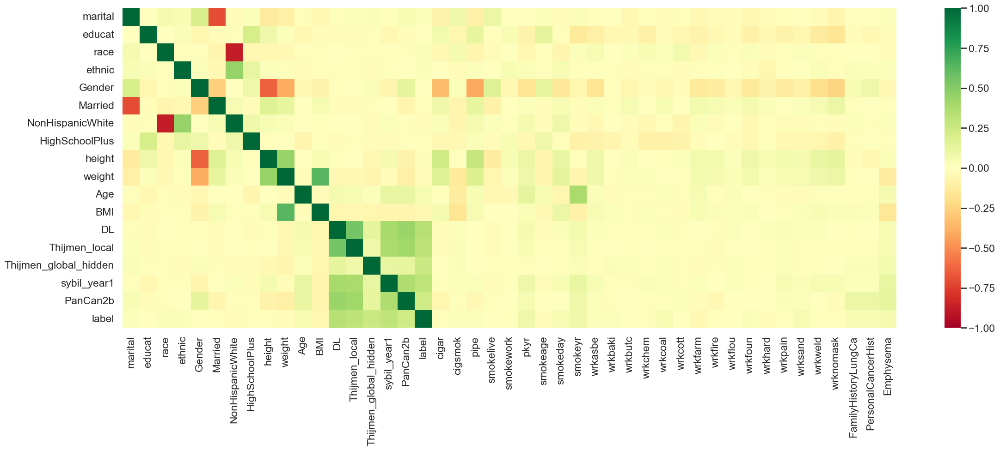

In [7]:
corr_rows = nlst_democols['cat']['demo'] + nlst_democols['num']['demo'] + list(MODEL_TO_COL.values()) + ['label']
corr_cols = corr_rows + nlst_democols['cat']['smoke'] + nlst_democols['num']['smoke'] + nlst_democols['cat']['work'] + nlst_democols['cat']['other']
corrmat = utils.corrmat(nlst_preds, corr_rows, corr_cols)

## Plot results by category

In [7]:
def modelstats_by_cat(df, cat, models=MODEL_TO_COL):
    groups = df.groupby(cat)
    
    df_catinfo, _ = utils.info_by_splits(groups, min_mal=0)
    for m in models:
        means, stds = {}, {}
        for val, df_group in groups:
            means[val] = df_group[models[m]].mean()
            stds[val] = df_group[models[m]].std()
        df_catinfo[f'{m}_mean'] = means
        df_catinfo[f'{m}_std'] = stds

    return df_catinfo

In [8]:
sigtest =  mannwhitneyu

In [9]:
def dist_sig_by_cat(df, cat, models=MODEL_TO_COL):
    groups = df.groupby(cat)
    result = {}
    for m in models:
        display(Markdown(f"#### {m}"))
        stats, pvals = {}, {}

        for a, dfa in groups:
            stats[a] = {a: 0}
            pvals[a] = {a: 1} 
            for b, dfb in groups:
                if a == b: continue
                res = sigtest(dfa[models[m]], dfb[models[m]], nan_policy='omit', alternative='two-sided')
                stats[a][b] = res.statistic
                pvals[a][b] = res.pvalue
        
        stats_df = pd.DataFrame(stats)
        print("Statistics:")
        display(stats_df)

        pvals_df = pd.DataFrame(pvals)
        print("P-Values:")
        display(pvals_df)

        result[m] = {'stats': stats_df, 'pvals': pvals_df}
    
    return result

def dist_sig_by_cat_and_mal(df, cat, models=MODEL_TO_COL):
    display(Markdown(f"### Benign"))
    benign_result = dist_sig_by_cat(df.query('label == 0'), cat, models)
    display(Markdown(f"### Malignant"))
    malignant_result = dist_sig_by_cat(df.query('label == 1'), cat, models)
    return benign_result, malignant_result

In [10]:
def dist_by_category(df, cat, models=MODEL_TO_COL):
    fig, ax = plt.subplots(2, len(models), figsize=(6.5*len(models) - 0.5, 13))
    fig.suptitle(f'Model Scores Split by {cat} (top: benign, bottom: malignant)')
    df_by_label = df.groupby('label')
    catvals = df[cat].dropna().unique()

    for j, dfj in df_by_label:
        for i, m in enumerate(models):
            sns.histplot(data=dfj, ax=ax[j][i], x=models[m], hue=cat, common_norm=False, element='poly', stat='density')
            ax[j][i].set_title(f'{m}')
            # ax[j][i].legend([f'{v}: (m={np.around(dfj[dfj[cat] == v].mean(), 4)}, s={np.around(dfj[dfj[cat] == v].std(), 4)})' for v in catvals])
            
            if len(catvals) == 2:
                sample0 = dfj[dfj[cat] == catvals[0]][models[m]]
                sample1 = dfj[dfj[cat] == catvals[1]][models[m]]
                res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
                ax[j][i].set_title(f'{m}: (z={np.around(res.statistic, 6)}, p={np.around(res.pvalue, 6)})')
    
    plt.tight_layout()
    plt.show()

In [11]:
def plot_by_category(df, c):
    display(Markdown(f"### {c}"))
    display(modelstats_by_cat(nlst_preds, c))
    dist_by_category(nlst_preds, c)
    # dist_sig_by_cat_and_mal(nlst_preds, c)
    # dist_sig_by_cat(nlst_preds, c)

### Included columns (from predictions)

### wrknomask

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,4407,74.555913,442,10.029499,0.221923,0.336691,0.257849,0.352480,0.290261,0.337662,0.039344,0.096374,0.068776,0.106091
True,1504,25.444087,139,9.242021,0.223002,0.333729,0.240320,0.343149,0.298111,0.341081,0.038519,0.093370,0.065057,0.099942


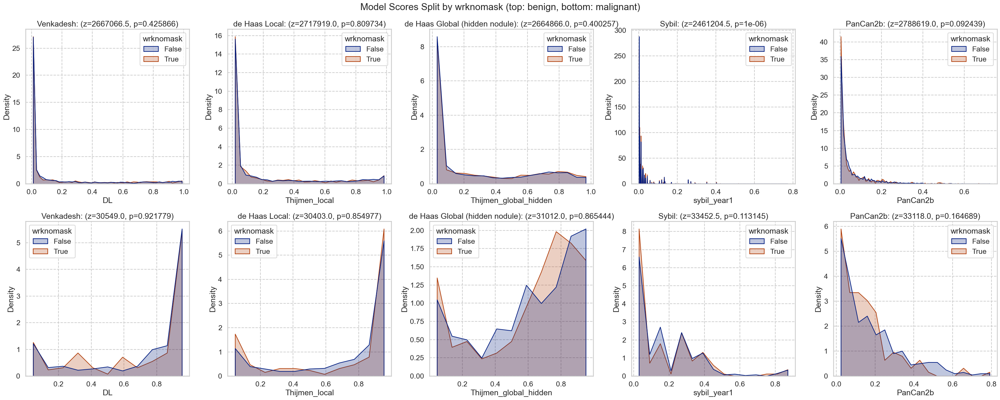

### FamilyHistoryLungCa

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,4384,74.166808,401,9.146898,0.219391,0.334103,0.250522,0.347162,0.287061,0.336533,0.037484,0.091552,0.060906,0.095906
True,1527,25.833192,180,11.787819,0.230256,0.341034,0.261618,0.358705,0.307180,0.343848,0.043872,0.106299,0.087708,0.124070


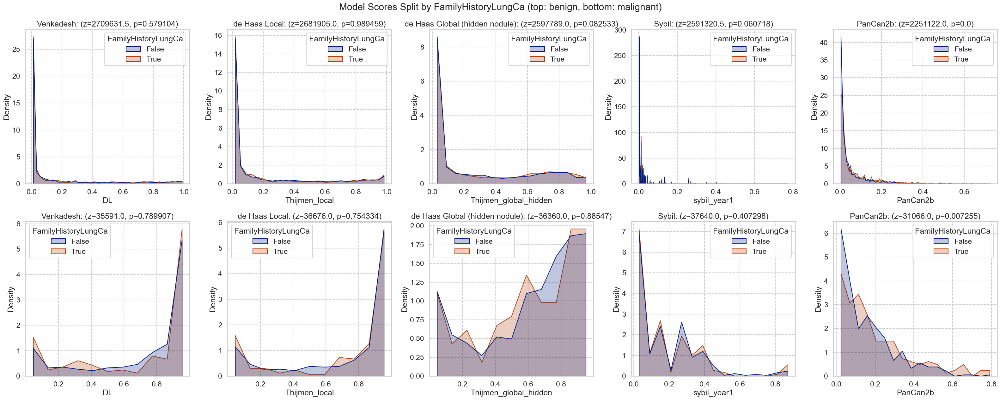

### PersonalCancerHist

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,4183,70.766368,377,9.012670,0.219078,0.333364,0.250067,0.347134,0.285331,0.336630,0.036699,0.089777,0.060217,0.095225
True,1728,29.233632,204,11.805556,0.229750,0.341981,0.261430,0.357433,0.309029,0.342583,0.045029,0.108245,0.086257,0.122388


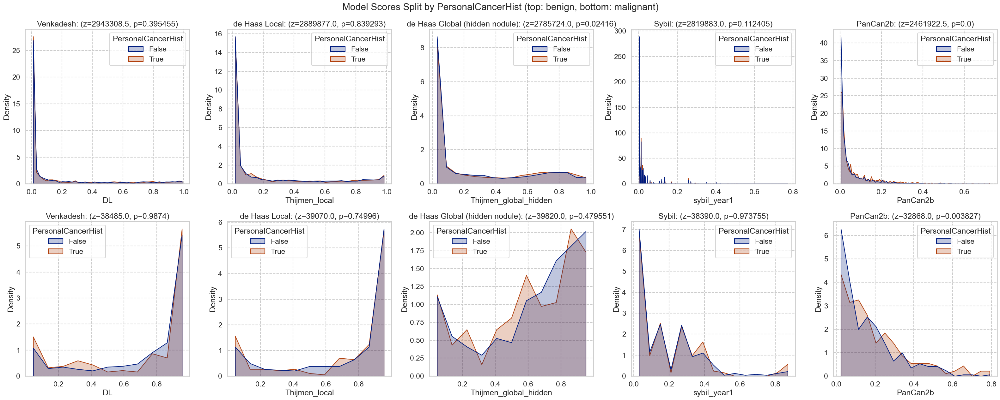

### Emphysema

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,3755,63.52563,317,8.442077,0.20388,0.323770,0.237018,0.340102,0.274405,0.329920,0.035857,0.094528,0.058186,0.095592
True,2156,36.47437,264,12.244898,0.25410,0.353891,0.281900,0.365415,0.323354,0.350924,0.044841,0.097227,0.084625,0.116718


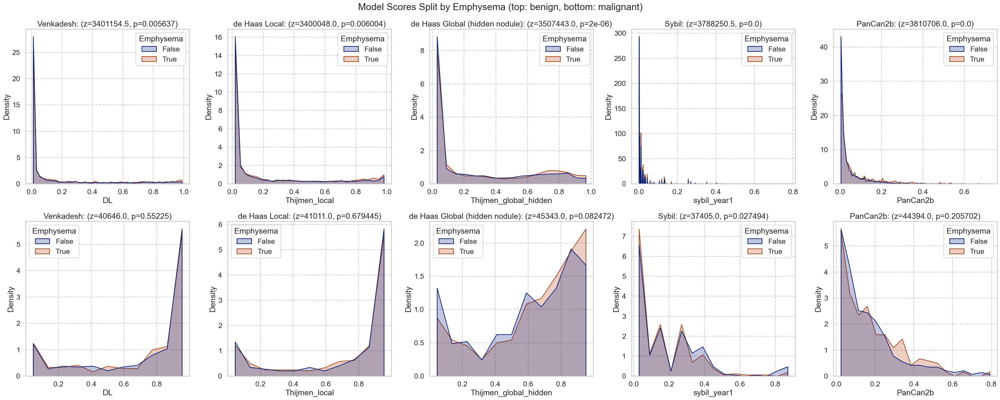

In [12]:
for c in nlst_democols['cat']['other']:
    plot_by_category(nlst_preds, c)

### Demographics

### marital

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,229,3.882672,16,6.986900,0.224347,0.338951,0.229805,0.332681,0.263474,0.331685,0.043074,0.111305,0.077109,0.118638
2.0,3974,67.378772,384,9.662808,0.215627,0.331924,0.247020,0.345890,0.291653,0.338221,0.038558,0.095534,0.064193,0.102955
3.0,507,8.596134,49,9.664694,0.250114,0.350727,0.285886,0.365621,0.292703,0.337253,0.041973,0.099150,0.076682,0.103056
4.0,65,1.102068,5,7.692308,0.195365,0.334043,0.221192,0.337269,0.302708,0.317448,0.028958,0.065749,0.067342,0.107140
5.0,1123,19.040353,125,11.130899,0.232849,0.341996,0.265517,0.360587,0.301612,0.343439,0.039706,0.092508,0.073910,0.105414


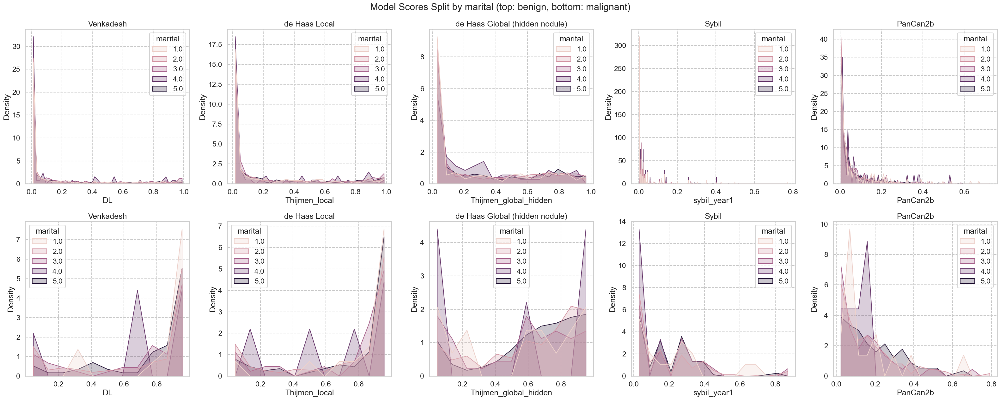

### educat

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,111,1.913793,9,8.108108,0.232598,0.333204,0.236352,0.325930,0.374996,0.361277,0.039015,0.108610,0.078292,0.109287
2.0,290,5.000000,32,11.034483,0.284934,0.354637,0.295290,0.365372,0.290585,0.340707,0.047815,0.106042,0.075528,0.097406
3.0,1479,25.500000,141,9.533469,0.224666,0.338562,0.262977,0.356113,0.294122,0.341800,0.043449,0.104328,0.070902,0.107067
4.0,852,14.689655,87,10.211268,0.224760,0.342774,0.238751,0.347721,0.272790,0.336318,0.037583,0.089978,0.062228,0.102047
5.0,1301,22.431034,126,9.684858,0.226119,0.338533,0.258895,0.356098,0.290722,0.334579,0.037472,0.090788,0.070544,0.110287
6.0,913,15.741379,96,10.514786,0.203725,0.326175,0.243256,0.339973,0.280825,0.334545,0.035907,0.089811,0.057320,0.084545
7.0,854,14.724138,76,8.899297,0.199669,0.322368,0.235111,0.339563,0.313029,0.341056,0.036338,0.091879,0.071025,0.113294


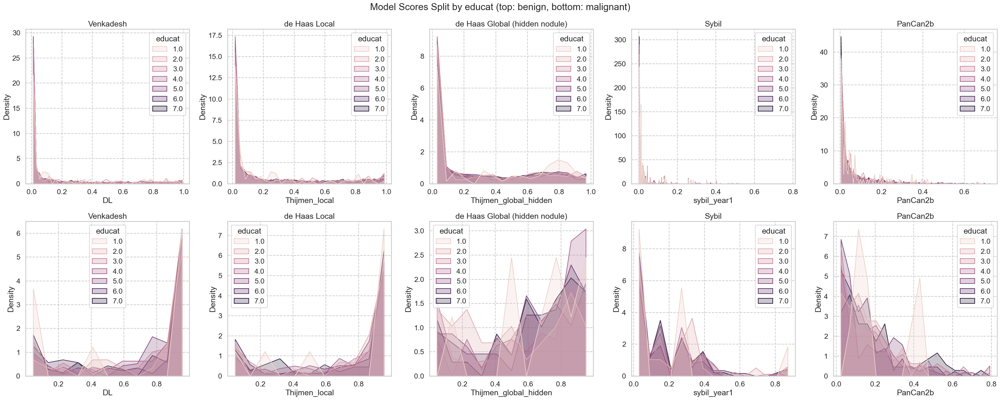

### race

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,5523,93.785023,530,9.596234,0.221983,0.335230,0.253416,0.350037,0.291345,0.338445,0.039182,0.095789,0.067461,0.104207
2.0,188,3.192393,28,14.893617,0.182292,0.303306,0.236117,0.333067,0.296413,0.312804,0.031508,0.078681,0.078690,0.100973
3.0,72,1.222618,6,8.333333,0.248087,0.371907,0.192860,0.307803,0.211630,0.310906,0.020843,0.065608,0.038067,0.057582
4.0,23,0.390559,8,34.782609,0.438118,0.395624,0.548908,0.437739,0.452653,0.399796,0.092241,0.099204,0.084787,0.104224
5.0,18,0.305655,1,5.555556,0.312917,0.424703,0.307411,0.402927,0.458265,0.409478,0.051181,0.108963,0.165624,0.219310
6.0,65,1.103753,6,9.230769,0.245923,0.380307,0.265003,0.375640,0.315335,0.373098,0.053425,0.097163,0.059457,0.091760


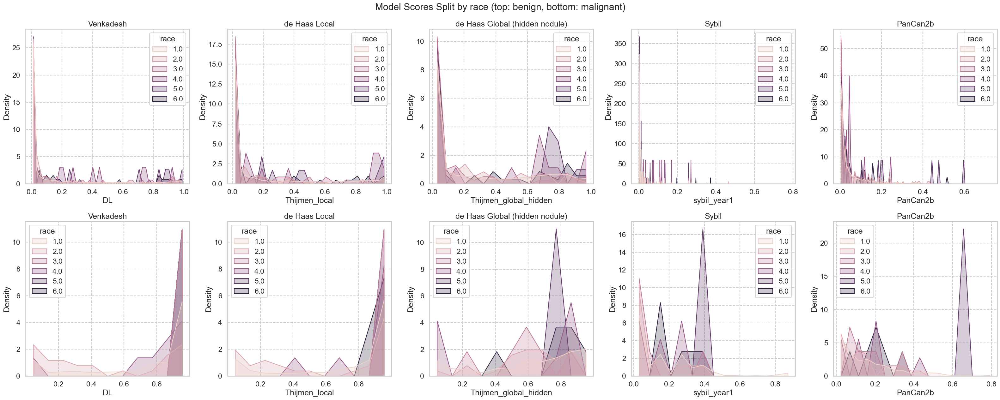

### ethnic

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,98,1.667517,4,4.081633,0.195984,0.322201,0.179458,0.299146,0.345360,0.350242,0.044196,0.140324,0.063209,0.092283
2.0,5779,98.332483,574,9.932514,0.222837,0.336264,0.254809,0.351024,0.291049,0.338173,0.039127,0.094772,0.067811,0.104416


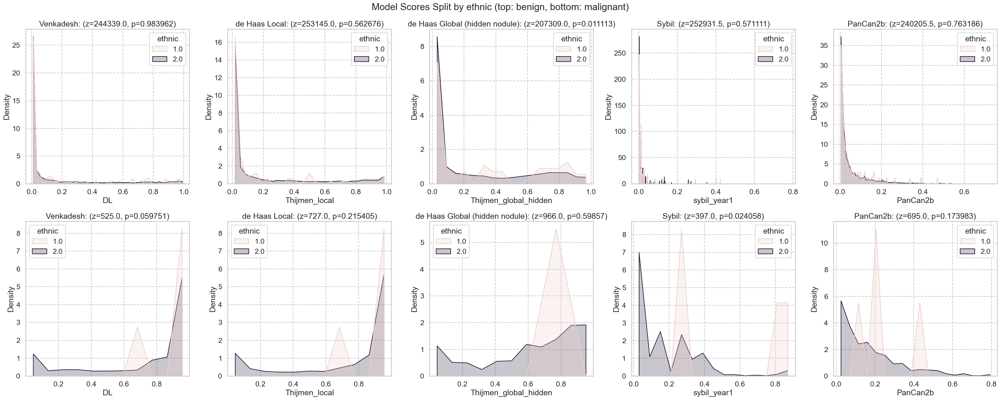

### Gender

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1,3441,58.2135,337,9.793665,0.224811,0.333238,0.255354,0.351398,0.287786,0.341782,0.037745,0.092590,0.058605,0.095229
2,2470,41.7865,244,9.878543,0.218558,0.339636,0.250651,0.348538,0.298490,0.333901,0.041068,0.099654,0.080680,0.115123


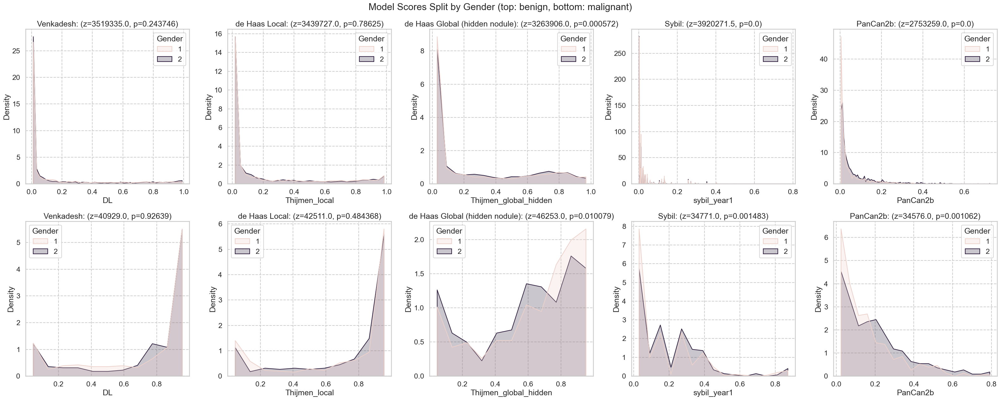

### Married

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,1937,32.769413,197,10.170367,0.235678,0.343643,0.266456,0.358569,0.293502,0.339227,0.040315,0.095783,0.075291,0.107436
True,3974,67.230587,384,9.662808,0.215627,0.331924,0.247020,0.345890,0.291653,0.338221,0.038558,0.095534,0.064193,0.102955


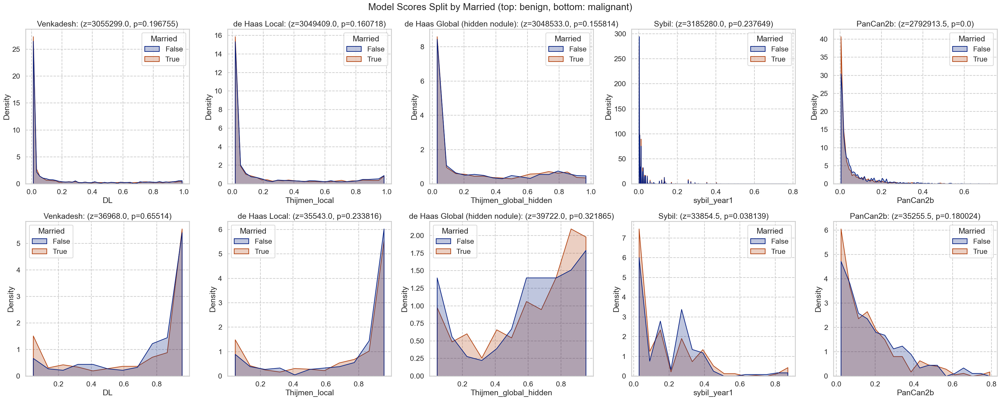

### NonHispanicWhite

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,481,8.137371,55,11.434511,0.222343,0.343311,0.239910,0.345266,0.309421,0.342683,0.039056,0.098583,0.071435,0.106302
True,5430,91.862629,526,9.686924,0.222185,0.335281,0.254583,0.350623,0.290738,0.338143,0.039141,0.095353,0.067510,0.104414


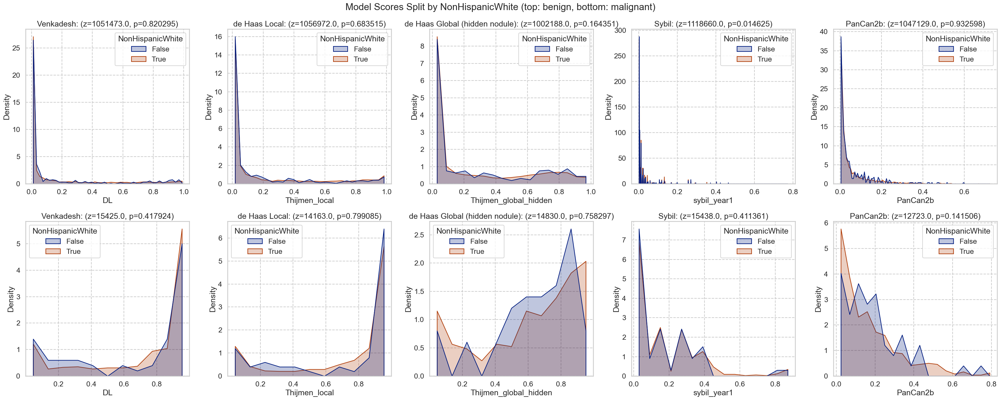

### HighSchoolPlus

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,111,1.877855,9,8.108108,0.232598,0.333204,0.236352,0.32593,0.374996,0.361277,0.039015,0.108610,0.078292,0.109287
True,5800,98.122145,572,9.862069,0.221999,0.335989,0.253715,0.35065,0.290675,0.337909,0.039136,0.095356,0.067629,0.104472


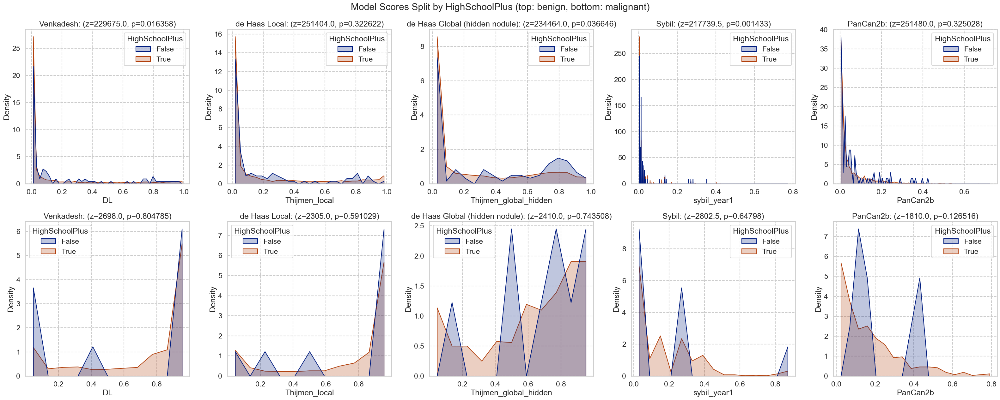

In [13]:
for cat in nlst_democols['cat']['demo']:
    plot_by_category(nlst_preds, cat)

### Smoking

### cigar

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,4738,80.496092,470,9.919797,0.224946,0.339311,0.256312,0.352323,0.293000,0.339383,0.040058,0.097421,0.070362,0.105858
1.0,1148,19.503908,109,9.494774,0.211996,0.322916,0.242273,0.341804,0.288285,0.335410,0.035274,0.087479,0.057731,0.097489


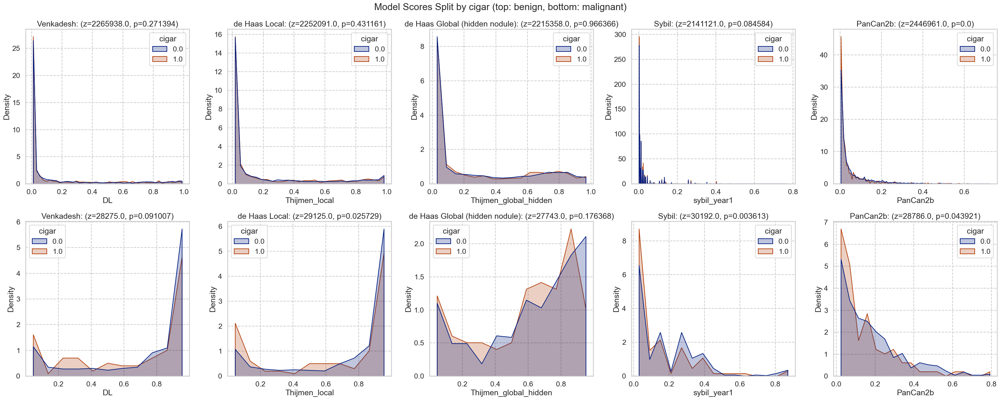

### cigsmok

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,2930,49.568601,267,9.112628,0.218016,0.332725,0.247383,0.347869,0.278184,0.334790,0.039957,0.098175,0.067560,0.105485
1,2981,50.431399,314,10.533378,0.226308,0.339021,0.259292,0.352403,0.306092,0.341645,0.038325,0.093031,0.068094,0.103670


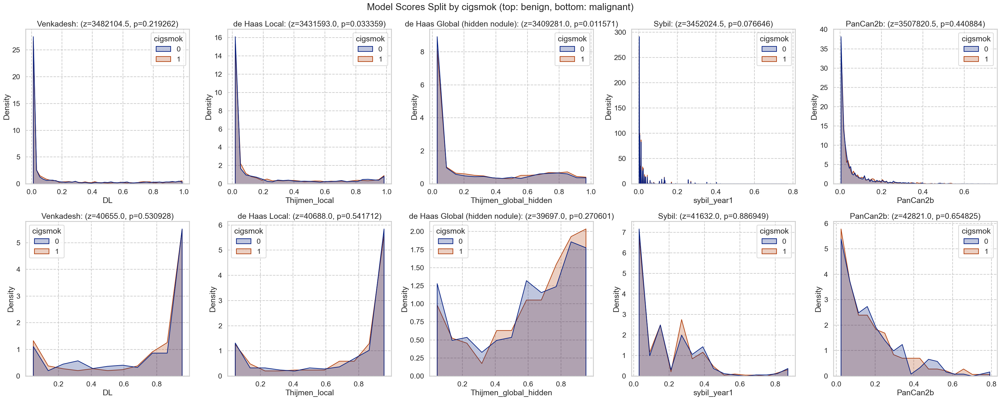

### pipe

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,4575,77.859088,436,9.530055,0.220890,0.337303,0.253099,0.351073,0.291662,0.337091,0.039494,0.095256,0.070192,0.106885
1.0,1301,22.140912,143,10.991545,0.228698,0.332979,0.255859,0.348371,0.295029,0.344366,0.037938,0.097020,0.059962,0.094997


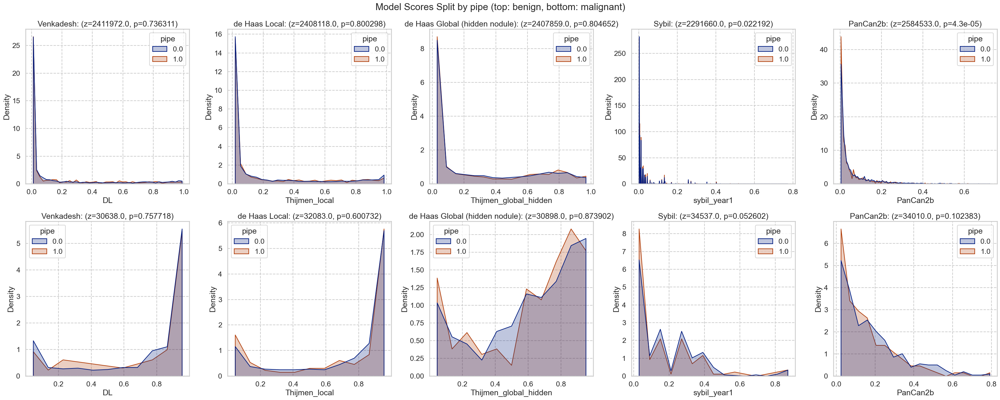

### smokelive

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,665,11.317223,64,9.62406,0.225061,0.332276,0.263831,0.349537,0.284107,0.335767,0.037248,0.089879,0.066107,0.104712
1.0,5211,88.682777,514,9.86375,0.222378,0.336850,0.252776,0.350539,0.293430,0.339193,0.039502,0.096538,0.068171,0.104383


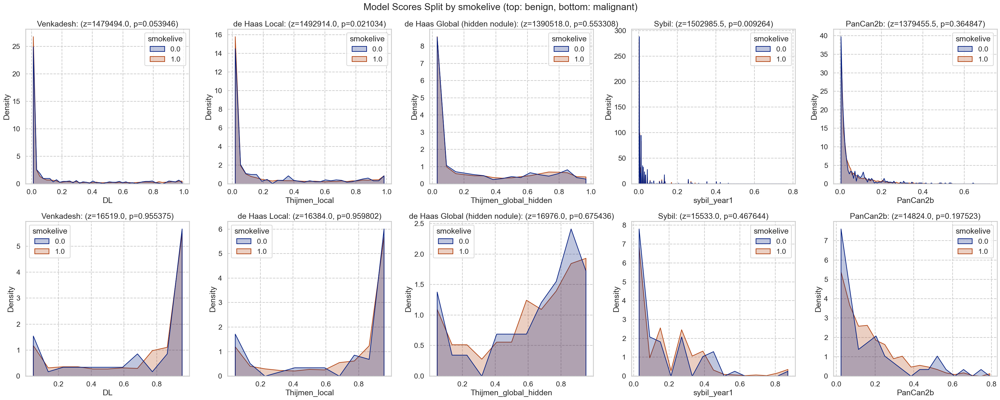

### smokework

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,722,12.314515,65,9.002770,0.222531,0.331654,0.255898,0.350299,0.279355,0.331715,0.035583,0.086670,0.064213,0.099681
1.0,5141,87.685485,512,9.959152,0.222247,0.336752,0.253493,0.350410,0.293606,0.339241,0.039866,0.097125,0.068374,0.105013


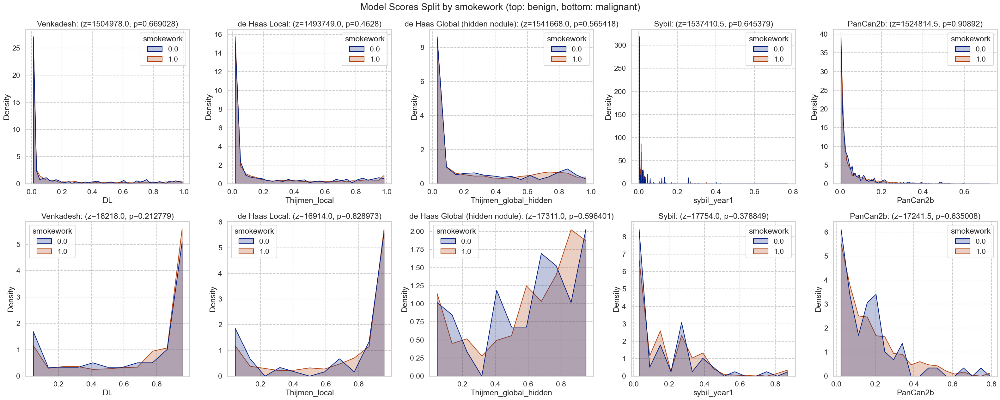

In [14]:
for cat in nlst_democols['cat']['smoke']:
    plot_by_category(nlst_preds, cat)

### Work history

### wrkasbe

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5610,94.923858,541,9.643494,0.220288,0.334442,0.252078,0.349377,0.293052,0.339029,0.038710,0.095123,0.067324,0.104032
1.0,300,5.076142,39,13.000000,0.257495,0.361540,0.278468,0.365074,0.276702,0.329433,0.047183,0.104291,0.075102,0.107681


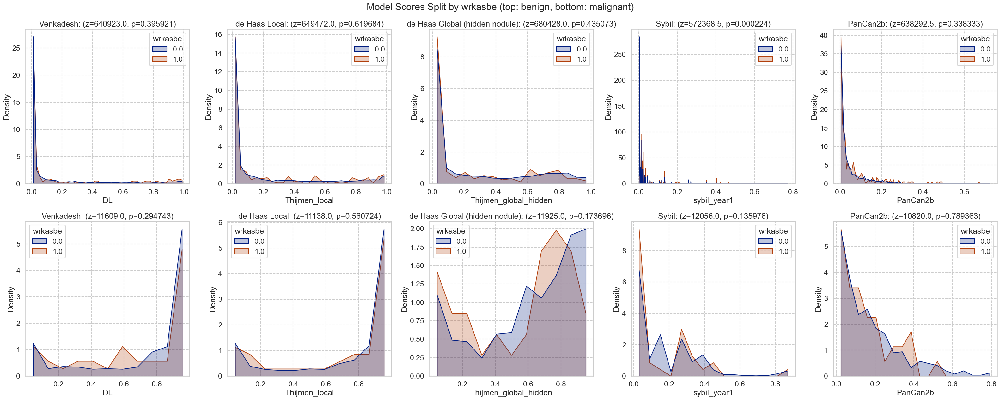

### wrkbaki

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5750,97.292724,560,9.73913,0.222465,0.336037,0.254216,0.350696,0.290057,0.338005,0.039556,0.096282,0.067846,0.104615
1.0,160,2.707276,20,12.50000,0.211811,0.333194,0.224745,0.331889,0.370013,0.349514,0.024185,0.066034,0.063124,0.089227


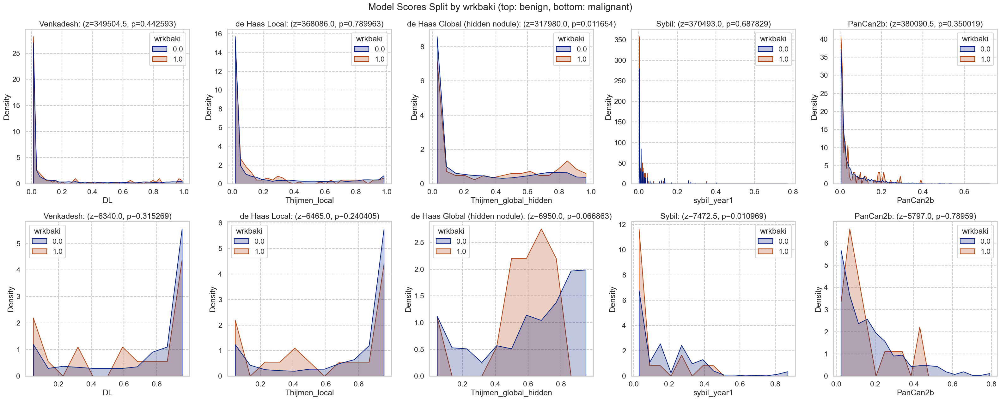

### wrkbutc

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5796,98.071066,570,9.834369,0.223447,0.336885,0.254714,0.351121,0.290764,0.338127,0.039332,0.095720,0.067977,0.104759
1.0,114,1.928934,10,8.771930,0.157616,0.277194,0.187506,0.293907,0.366349,0.352562,0.029392,0.090127,0.054579,0.071059


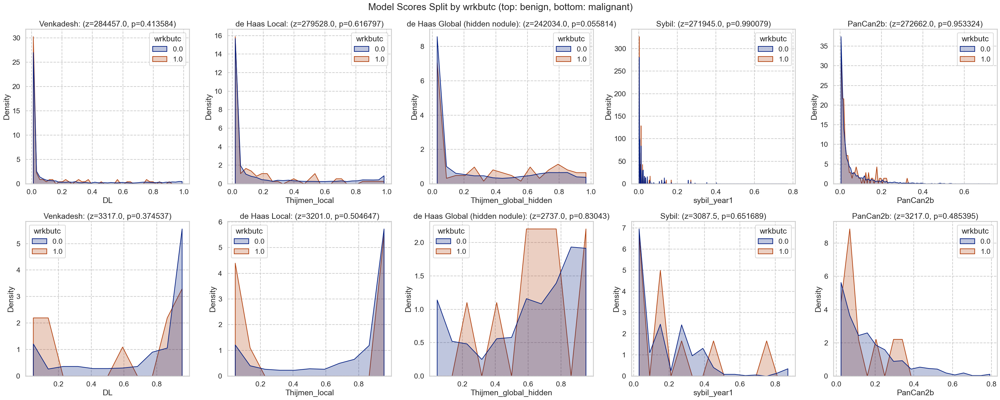

### wrkchem

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5515,93.348003,547,9.918404,0.220808,0.335004,0.254299,0.350766,0.291321,0.337904,0.039273,0.095550,0.067650,0.104728
1.0,393,6.651997,33,8.396947,0.242489,0.349059,0.241895,0.343140,0.306048,0.347914,0.037448,0.096883,0.068952,0.097201


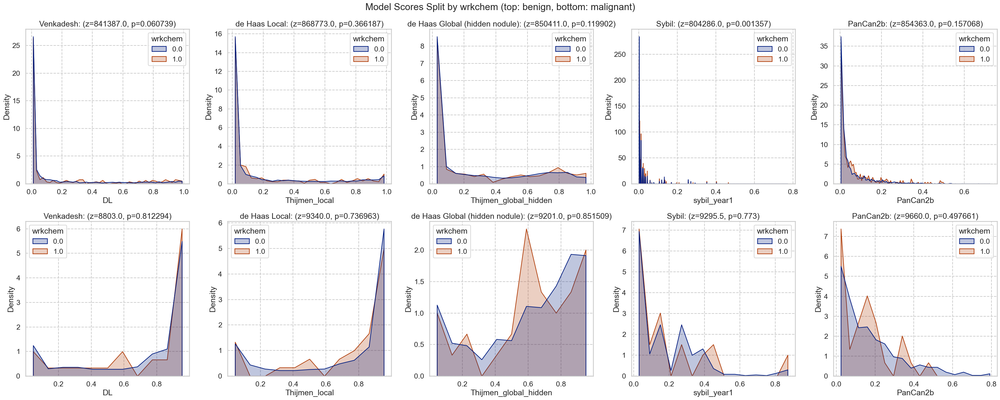

### wrkcoal

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5888,99.62775,573,9.731658,0.221952,0.335769,0.252957,0.349890,0.291442,0.338315,0.039027,0.095563,0.067500,0.103778
1.0,22,0.37225,7,31.818182,0.282223,0.381988,0.376872,0.417915,0.500887,0.342198,0.069512,0.107419,0.126195,0.183846


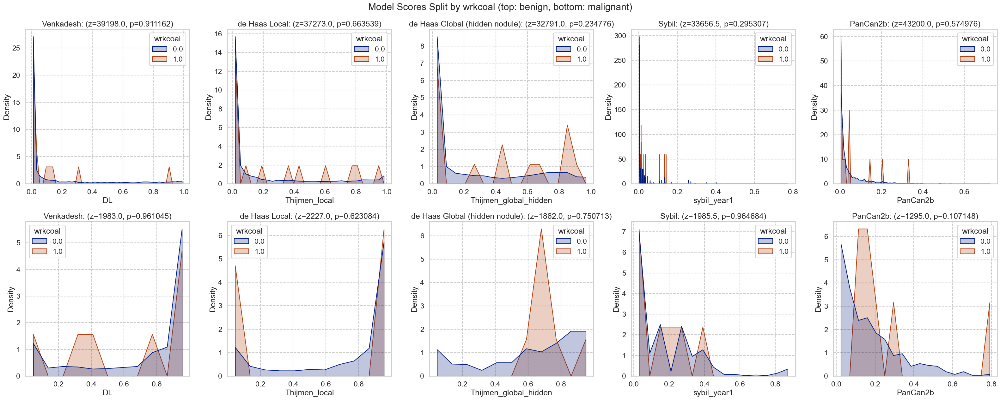

### wrkcott

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5858,99.120135,575,9.815637,0.221801,0.335784,0.253099,0.349969,0.292481,0.338591,0.039162,0.095728,0.067690,0.104425
1.0,52,0.879865,5,9.615385,0.264521,0.353546,0.289366,0.377939,0.263062,0.334733,0.036741,0.083064,0.070979,0.079063


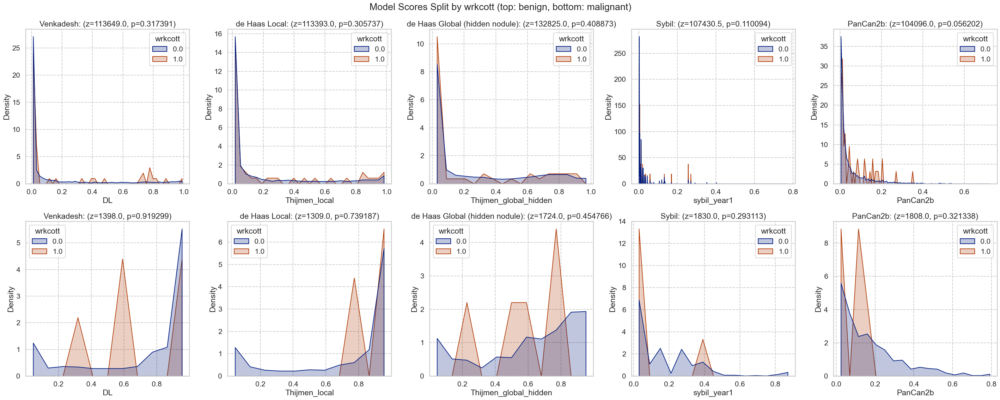

### wrkfarm

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5197,87.935702,533,10.255917,0.219951,0.334667,0.252869,0.350395,0.294912,0.339001,0.039159,0.096419,0.067864,0.103859
1.0,713,12.064298,47,6.591865,0.238399,0.344856,0.257418,0.349051,0.272610,0.334746,0.039000,0.089628,0.066661,0.106922


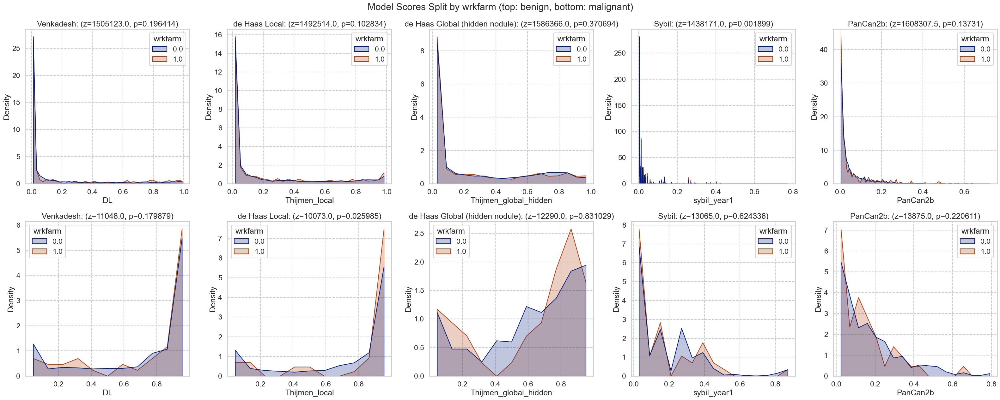

### wrkfire

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5776,97.732657,564,9.764543,0.223252,0.336601,0.254495,0.350845,0.292469,0.338692,0.039089,0.094983,0.068176,0.104444
1.0,134,2.267343,16,11.940299,0.175842,0.303454,0.206965,0.319203,0.281585,0.333021,0.041344,0.120275,0.048019,0.092472


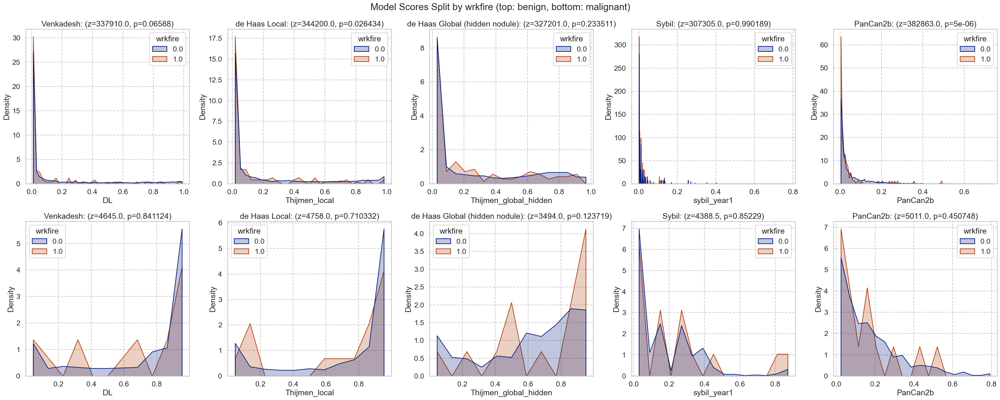

### wrkflou

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5847,98.93401,573,9.799897,0.221953,0.336190,0.253519,0.350548,0.291109,0.337734,0.039083,0.095270,0.067790,0.104420
1.0,63,1.06599,7,11.111111,0.242984,0.313334,0.244064,0.319277,0.395473,0.396135,0.044419,0.124589,0.061126,0.084484


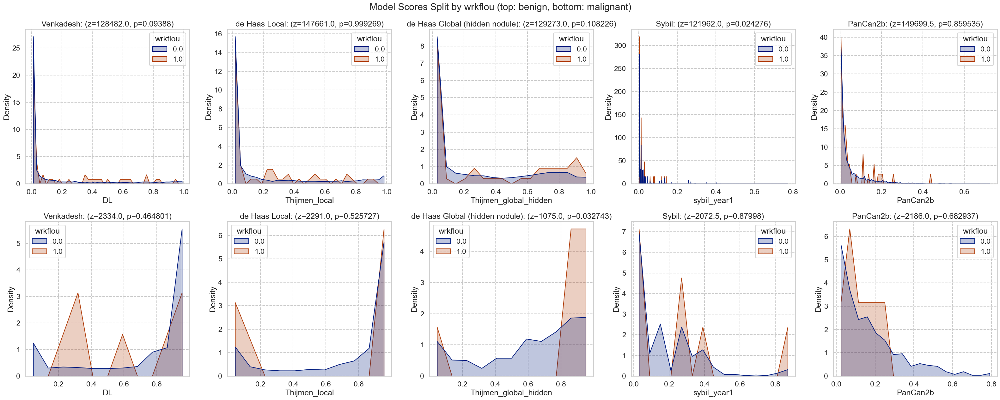

### wrkfoun

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5670,95.939086,545,9.611993,0.223221,0.336853,0.254002,0.350391,0.291667,0.338037,0.038891,0.094355,0.067738,0.104193
1.0,240,4.060914,35,14.583333,0.197506,0.313139,0.239607,0.346253,0.305323,0.350690,0.045028,0.121801,0.067268,0.105173


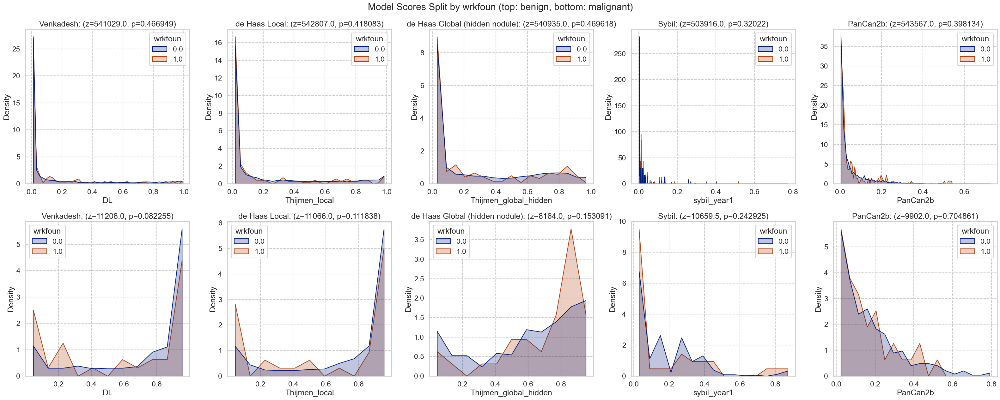

### wrkhard

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5858,99.120135,579,9.883919,0.222359,0.336655,0.254663,0.350948,0.292751,0.338525,0.039231,0.095431,0.067732,0.104348
1.0,52,0.879865,1,1.923077,0.201711,0.243197,0.113149,0.212456,0.232616,0.338181,0.028915,0.115397,0.066244,0.090080


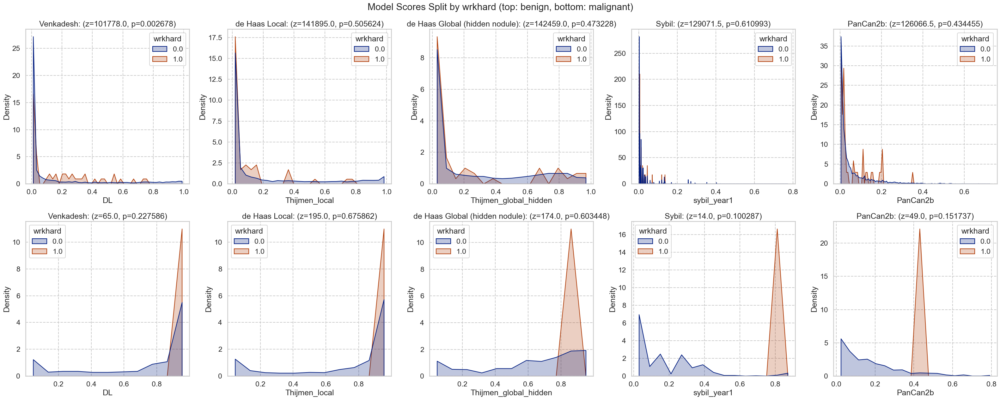

### wrkpain

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5593,94.63621,544,9.726444,0.218808,0.333977,0.251578,0.348926,0.290451,0.338078,0.038548,0.095183,0.066941,0.103781
1.0,317,5.36379,36,11.356467,0.281621,0.364267,0.285885,0.371155,0.323459,0.345654,0.049581,0.102589,0.081443,0.111041


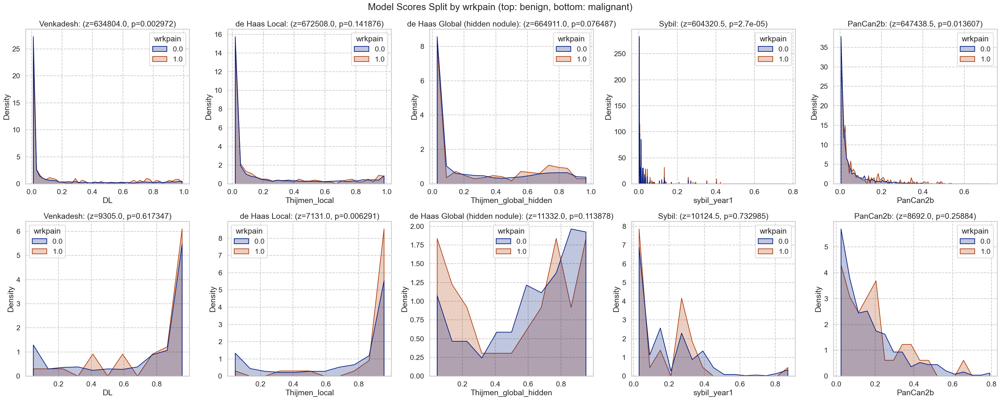

### wrksand

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5800,98.138748,558,9.62069,0.221287,0.335570,0.252720,0.349698,0.292827,0.338810,0.038921,0.095678,0.067393,0.103985
1.0,110,1.861252,22,20.00000,0.269115,0.353165,0.290227,0.375927,0.260325,0.323877,0.050688,0.092106,0.084896,0.115378


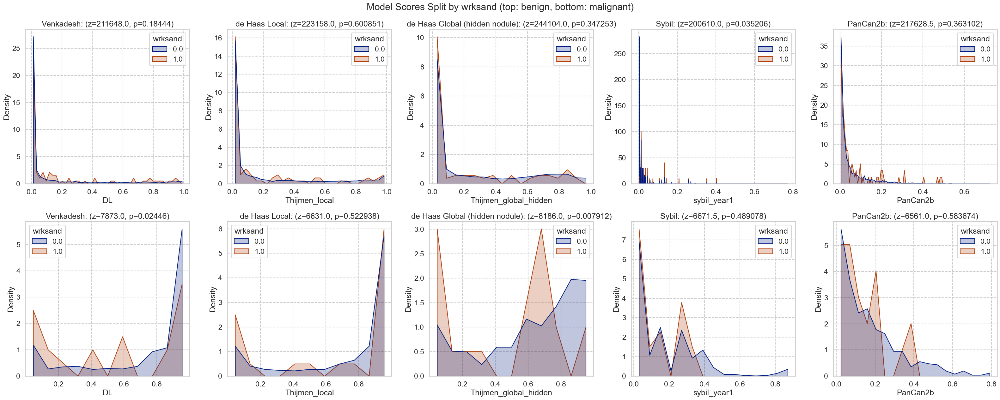

### wrkweld

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5550,93.908629,540,9.729730,0.219896,0.335064,0.252681,0.349818,0.292104,0.338498,0.038697,0.095446,0.067648,0.104345
1.0,360,6.091371,40,11.111111,0.257339,0.347697,0.264782,0.356449,0.294043,0.339655,0.045974,0.098113,0.068808,0.102493


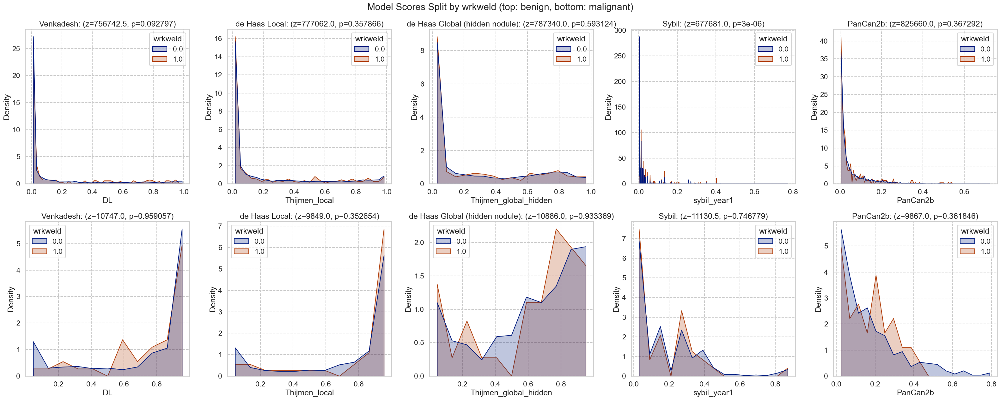

In [15]:
for cat in nlst_democols['cat']['work']:
    plot_by_category(nlst_preds, cat)

### Disease history

### Emphysema

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,3755,63.52563,317,8.442077,0.20388,0.323770,0.237018,0.340102,0.274405,0.329920,0.035857,0.094528,0.058186,0.095592
True,2156,36.47437,264,12.244898,0.25410,0.353891,0.281900,0.365415,0.323354,0.350924,0.044841,0.097227,0.084625,0.116718


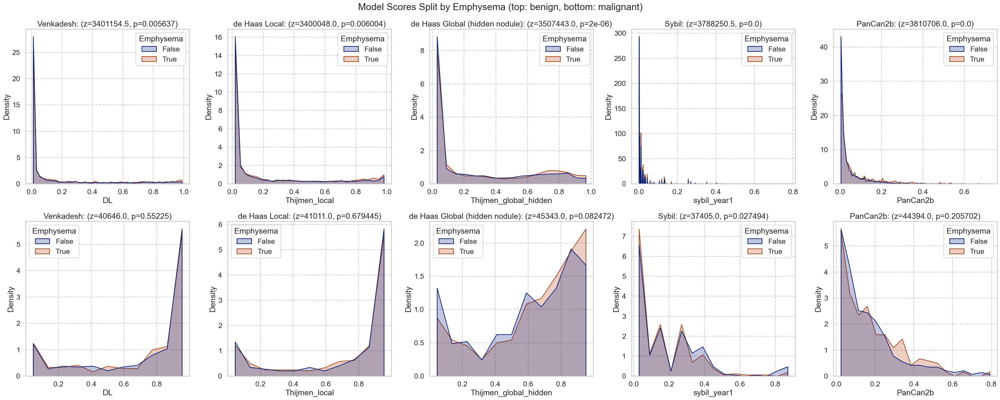

In [16]:
plot_by_category(nlst_preds, 'Emphysema')

### diagadas

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5534,93.653749,541,9.775931,0.217893,0.332994,0.248916,0.348247,0.288885,0.336324,0.037603,0.093420,0.066270,0.103521
1.0,375,6.346251,39,10.400000,0.285981,0.371616,0.320442,0.372304,0.340788,0.366955,0.061927,0.121575,0.089023,0.112233


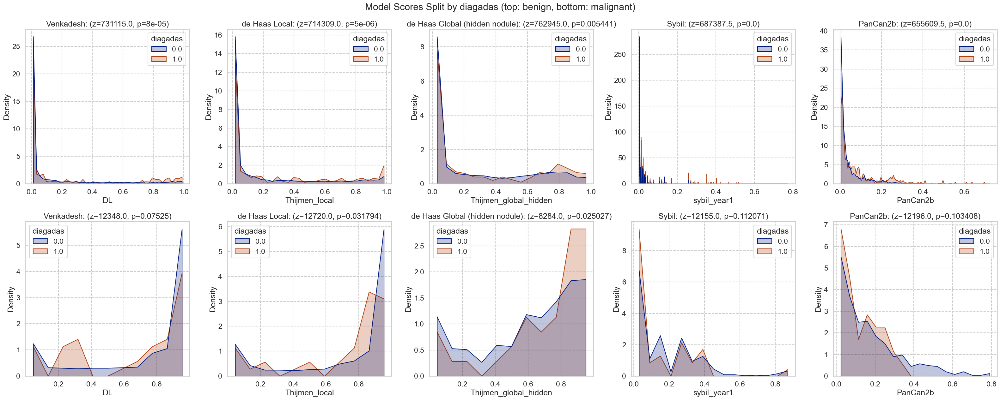

### diagasbe

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5838,98.898865,572,9.797876,0.223283,0.336789,0.254410,0.350643,0.292427,0.338537,0.039244,0.095772,0.067762,0.104377
1.0,65,1.101135,8,12.307692,0.138389,0.251053,0.165321,0.295016,0.254955,0.327100,0.028187,0.076435,0.059959,0.092438


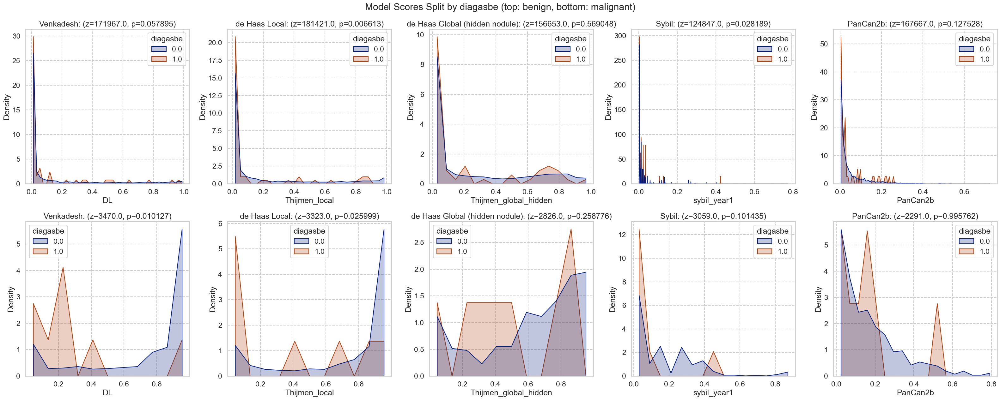

### diagbron

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5706,96.777476,564,9.884332,0.222136,0.336247,0.253546,0.349602,0.293512,0.338927,0.039257,0.095961,0.067618,0.104114
1.0,190,3.222524,13,6.842105,0.225276,0.327307,0.248334,0.363570,0.247032,0.325992,0.035664,0.085306,0.070858,0.109694


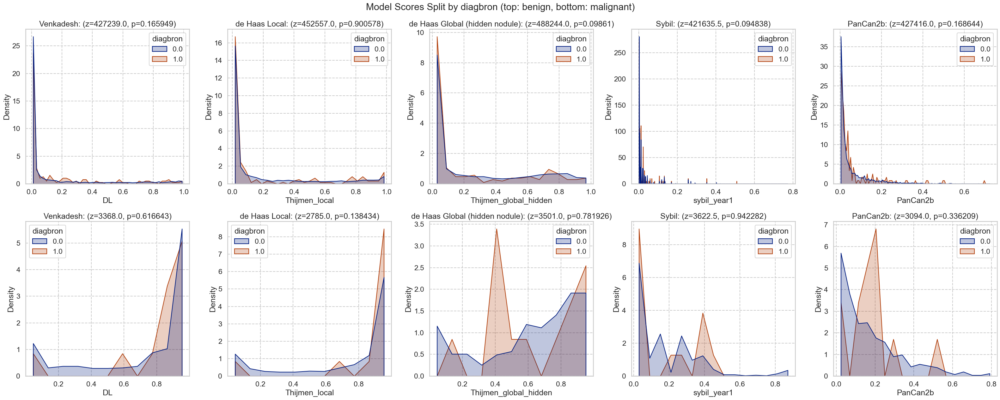

### diagchas

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5720,96.867062,566,9.895105,0.221391,0.335383,0.253273,0.349931,0.29084,0.338067,0.038886,0.095387,0.067641,0.104029
1.0,185,3.132938,14,7.567568,0.252258,0.354824,0.259364,0.358215,0.33394,0.352026,0.046094,0.101017,0.070874,0.111239


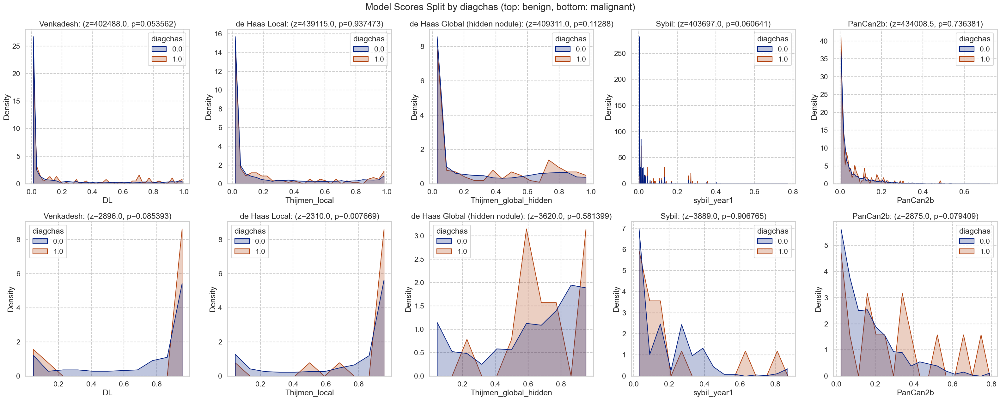

### diagchro

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5276,89.499576,521,9.874905,0.219291,0.334370,0.248544,0.348794,0.289950,0.336414,0.038294,0.094476,0.065051,0.101048
1.0,619,10.500424,56,9.046850,0.244629,0.347411,0.292761,0.358361,0.302534,0.351973,0.045536,0.103645,0.089688,0.124075


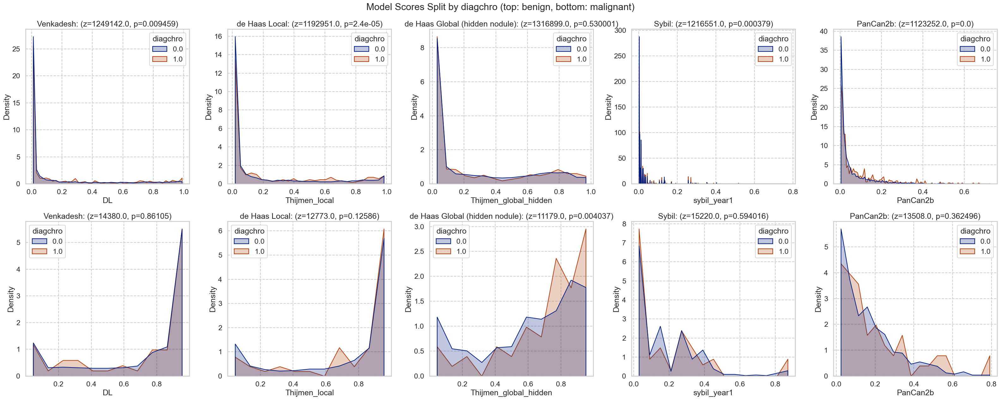

### diagcopd

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5492,93.195316,516,9.395484,0.214942,0.330750,0.244881,0.345674,0.288381,0.335679,0.037396,0.093177,0.064454,0.101387
1.0,401,6.804684,63,15.710723,0.324899,0.386934,0.371675,0.387554,0.345144,0.373488,0.063514,0.122288,0.111104,0.127415


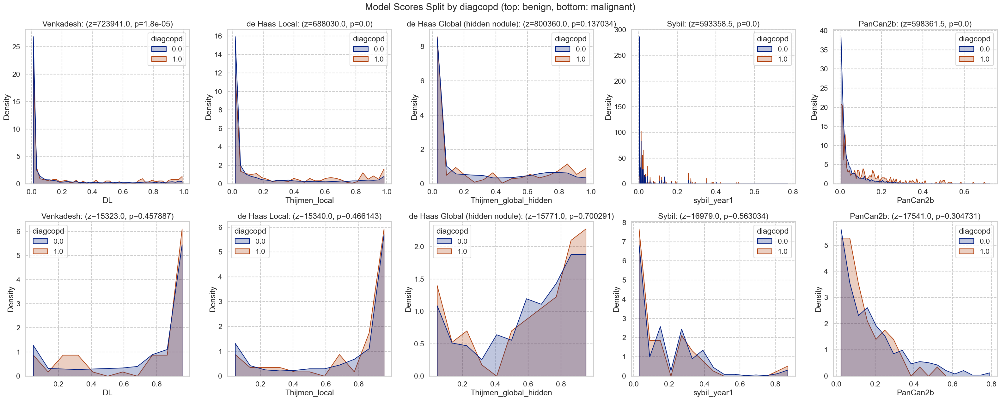

### diagdiab

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5362,90.773658,523,9.753823,0.223120,0.336082,0.254058,0.349931,0.294785,0.339062,0.038277,0.092516,0.067798,0.103981
1.0,545,9.226342,57,10.458716,0.214077,0.335250,0.246711,0.352386,0.265951,0.332426,0.047187,0.121265,0.067020,0.106840


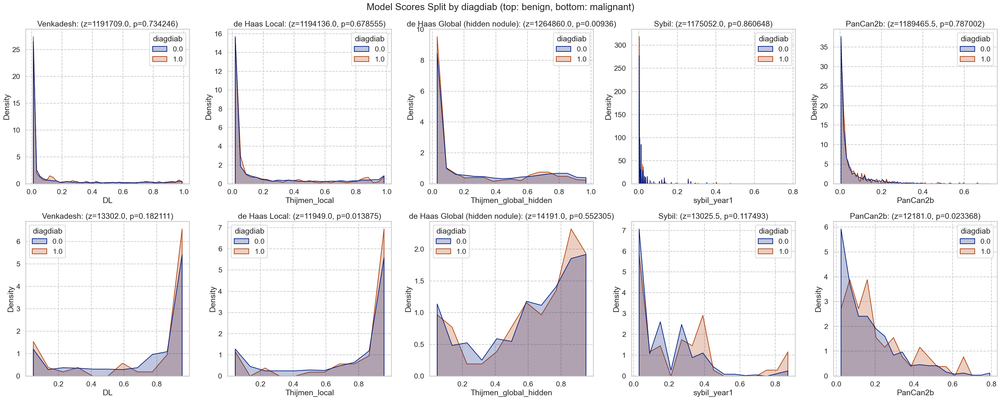

### diagemph

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5265,89.237288,497,9.439696,0.213796,0.330679,0.243392,0.345223,0.287138,0.334889,0.036790,0.092830,0.065077,0.102486
1.0,635,10.762712,82,12.913386,0.294583,0.370644,0.339165,0.379600,0.337190,0.365756,0.059146,0.114881,0.090101,0.115849


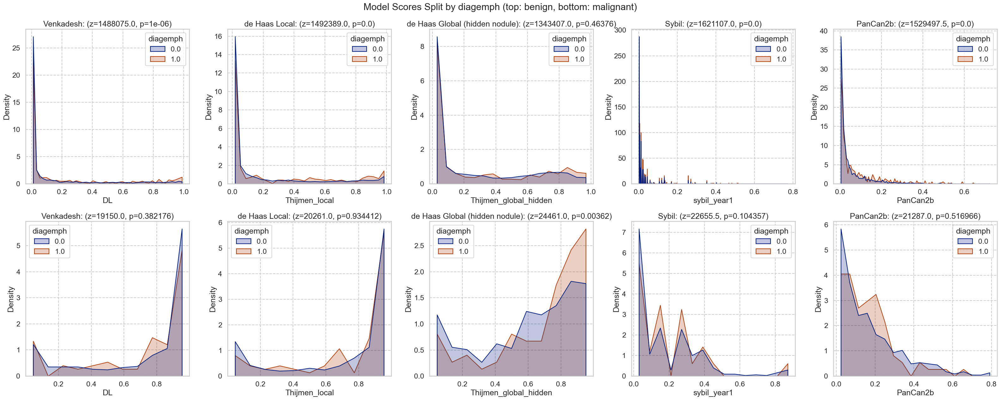

### diagfibr

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5887,99.762752,578,9.818244,0.221894,0.335652,0.253232,0.350126,0.291736,0.338366,0.039028,0.095471,0.067751,0.104341
1.0,14,0.237248,2,14.285714,0.454401,0.444267,0.398127,0.380810,0.487770,0.404306,0.083509,0.136066,0.072927,0.078234


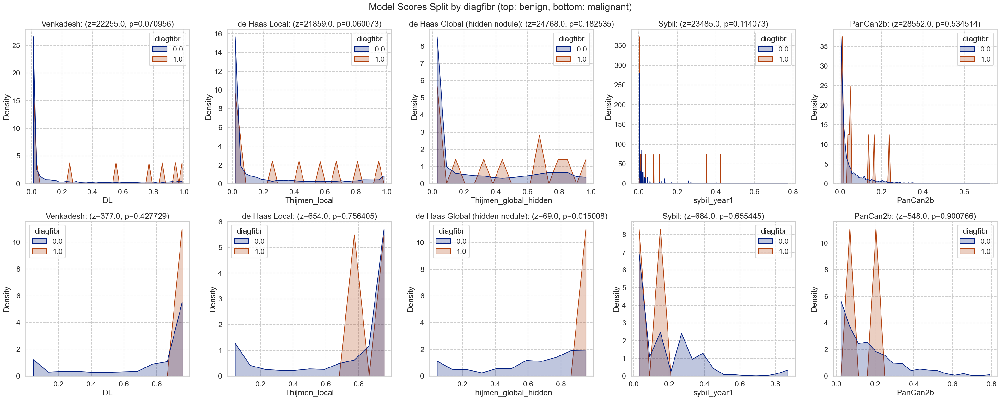

### diaghear

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5087,86.381389,492,9.671712,0.214571,0.331162,0.244765,0.344481,0.293398,0.338005,0.037890,0.094443,0.066072,0.102482
1.0,802,13.618611,87,10.847880,0.275031,0.363029,0.310417,0.381309,0.284382,0.343083,0.047536,0.102857,0.078184,0.114659


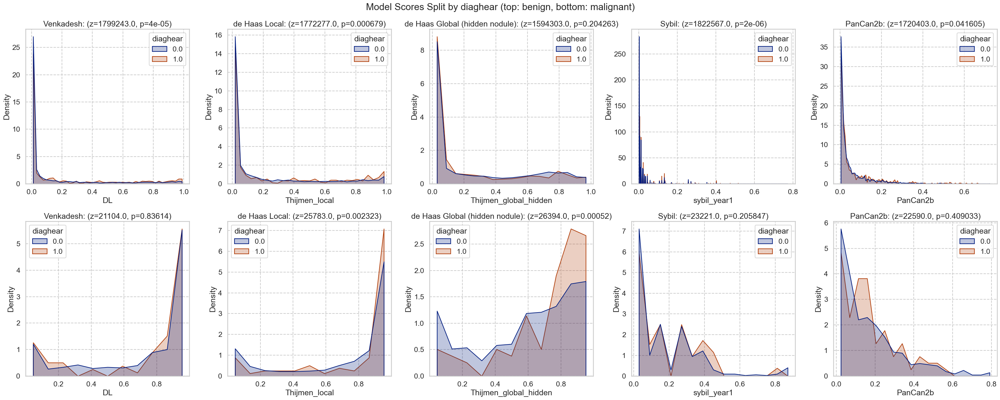

### diaghype

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,3909,66.231786,352,9.004861,0.217265,0.332982,0.242501,0.343133,0.288049,0.335104,0.038026,0.095084,0.066248,0.103432
1.0,1993,33.768214,223,11.189162,0.230665,0.340911,0.274122,0.362522,0.299004,0.344283,0.041193,0.096713,0.070274,0.105412


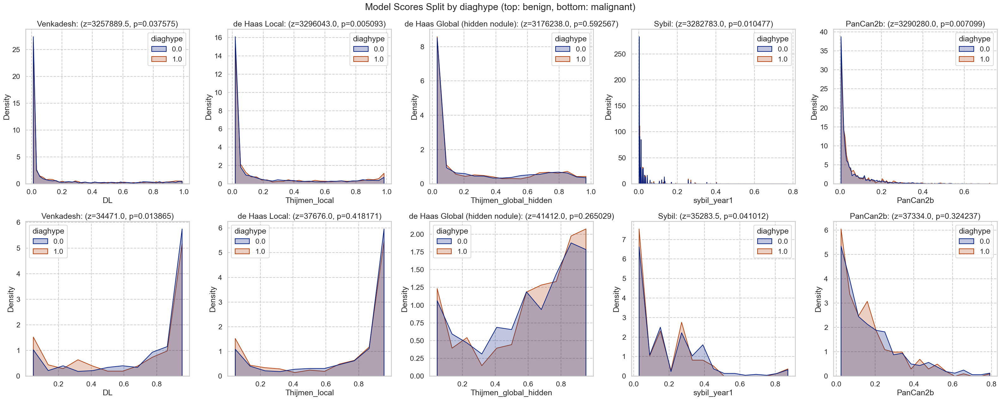

### diagpneu

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,4514,76.56038,438,9.703146,0.214940,0.332477,0.247215,0.346444,0.287897,0.336998,0.038583,0.097233,0.062873,0.098528
1.0,1382,23.43962,136,9.840810,0.246448,0.346214,0.273546,0.361204,0.305231,0.343148,0.040667,0.089761,0.083037,0.119560


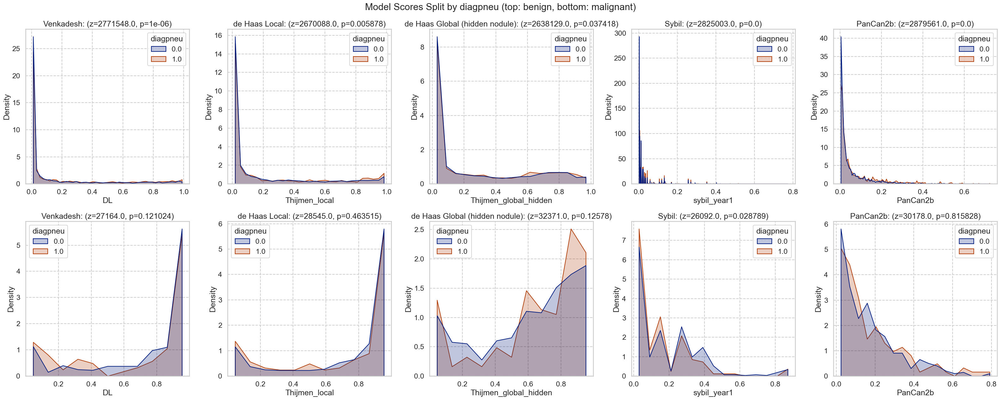

### diagsarc

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5889,99.83048,576,9.780948,0.221832,0.335728,0.253171,0.349911,0.292116,0.338579,0.039051,0.095511,0.067591,0.104022
1.0,10,0.16952,2,20.000000,0.352419,0.374899,0.276941,0.362435,0.205017,0.330947,0.030246,0.053523,0.125218,0.167620


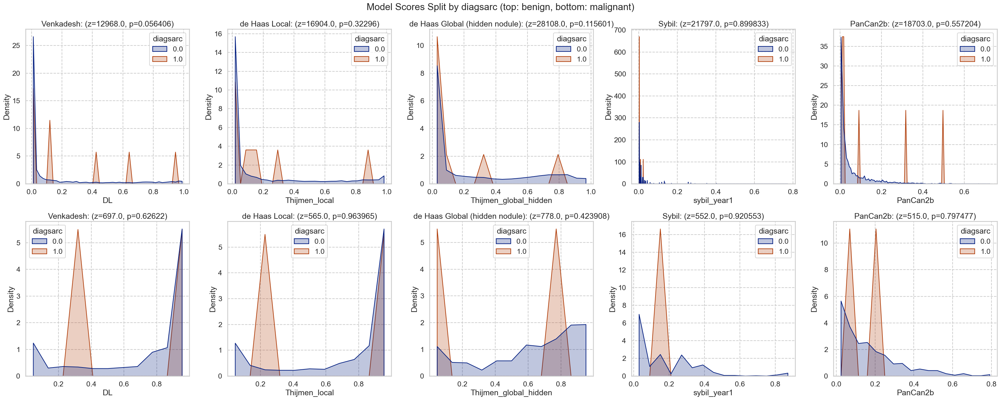

### diagsili

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5887,99.796576,574,9.750297,0.222304,0.336061,0.253333,0.350097,0.291864,0.338445,0.039064,0.095538,0.067660,0.104214
1.0,12,0.203424,4,33.333333,0.099154,0.121849,0.193687,0.238803,0.342746,0.403653,0.025267,0.033361,0.081784,0.079461


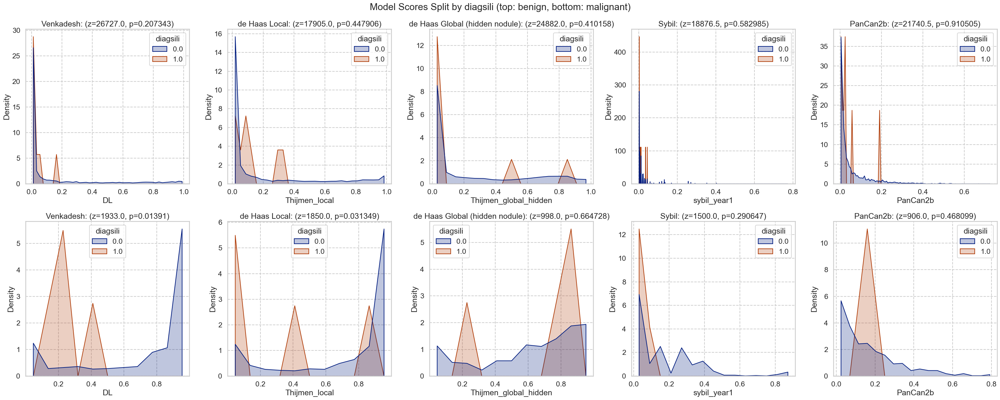

### diagstro

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5710,96.681341,556,9.737303,0.222429,0.335628,0.252344,0.349182,0.292052,0.338700,0.038310,0.093737,0.066989,0.103259
1.0,196,3.318659,24,12.244898,0.219221,0.347629,0.284436,0.377106,0.291749,0.333448,0.062296,0.136831,0.089528,0.128150


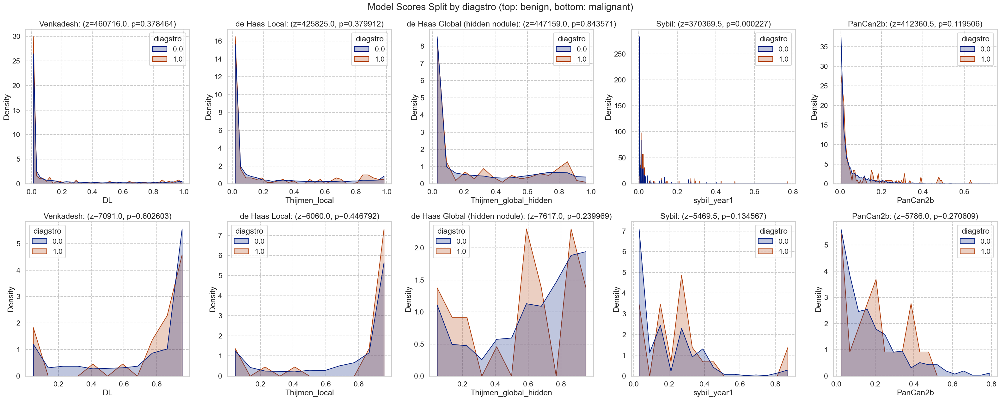

### diagtube

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,5839,98.882303,569,9.744819,0.220692,0.335140,0.252187,0.349357,0.290683,0.338071,0.039090,0.095836,0.067358,0.103832
1.0,66,1.117697,11,16.666667,0.369786,0.381368,0.366484,0.402616,0.425577,0.357939,0.041034,0.068201,0.101671,0.133160


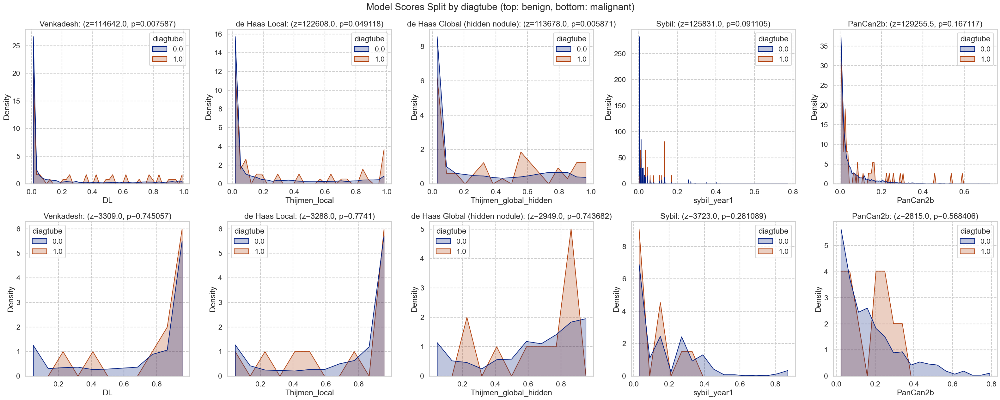

In [17]:
for cat in nlst_democols['cat']['disease']:
    plot_by_category(nlst_preds, cat)

## Binning for numerical columns

### Demographic columns

#### height

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5322.0,67.992108,3.975060,53.0,65.0,68.0,71.0,83.0
1,579.0,67.867012,3.938709,59.0,65.0,68.0,71.0,76.0


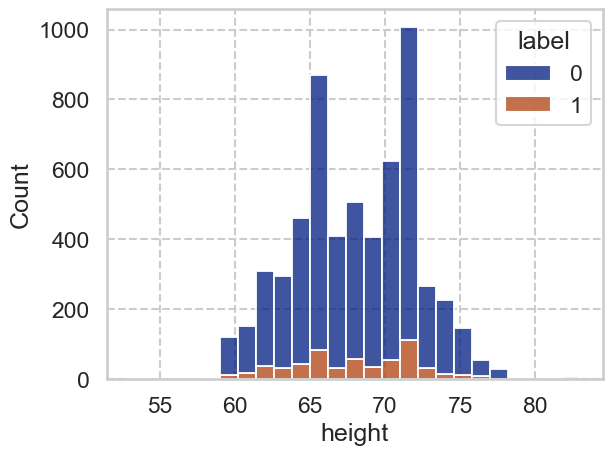

#### weight

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5323.0,182.510802,39.453415,75.0,155.0,180.0,205.0,368.0
1,575.0,176.481739,36.847637,95.0,150.0,175.0,200.0,322.0


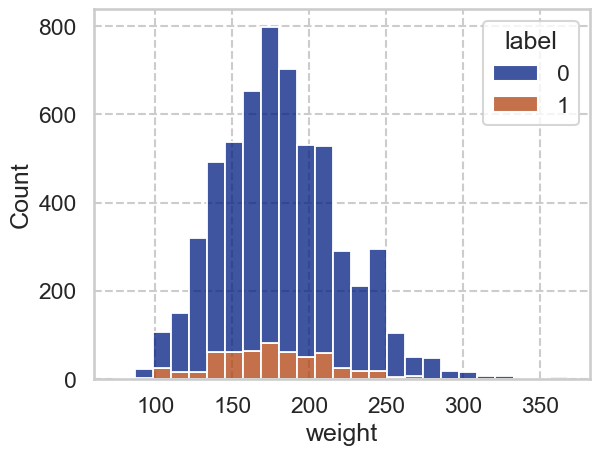

#### Age

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,63.088180,5.263707,54.0,59.0,62.0,67.0,76.0
1,581.0,64.061962,5.202746,55.0,60.0,64.0,68.0,76.0


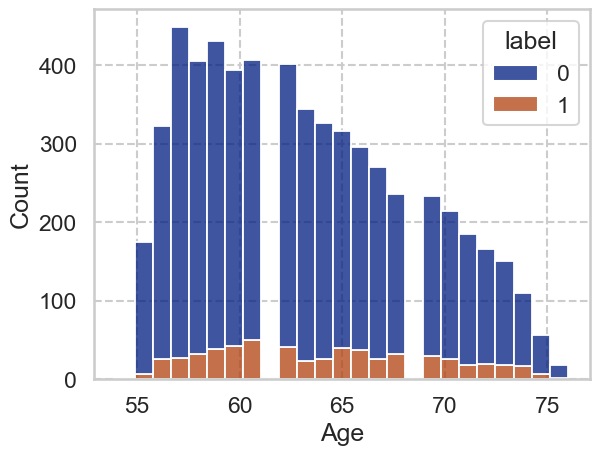

#### BMI

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5318.0,27.63764,4.984482,13.284203,24.209972,27.005931,30.550293,57.630653
1,574.0,26.79225,4.402291,16.432432,24.207989,26.172647,29.049587,47.587692


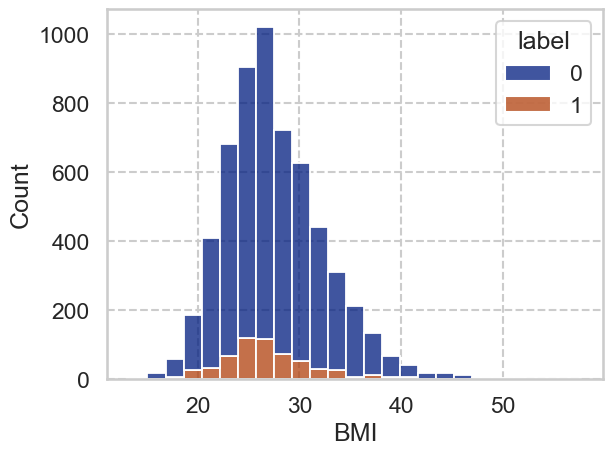

In [18]:
for c in nlst_democols['num']['demo']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                               height  \
                 count      mean       std  min  25%  50%  75%  max   count   
bin_height                                                                    
(52.999, 68.0]  3134.0  0.099553  0.299451  0.0  0.0  0.0  0.0  1.0  3134.0   
(68.0, 83.0]    2767.0  0.096494  0.295321  0.0  0.0  0.0  0.0  1.0  2767.0   

                                                                   
                     mean       std   min   25%   50%   75%   max  
bin_height                                                         
(52.999, 68.0]  64.869177  2.355045  53.0  63.0  65.0  67.0  68.0  
(68.0, 83.0]    71.503072  1.994545  69.0  70.0  71.0  73.0  83.0

### bin_height

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\2396763895.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
"(52.999, 68.0]",3134,53.109642,312,9.955329,0.220647,0.340014,0.246697,0.347355,0.298870,0.336700,0.041066,0.100843,0.073906,0.111685
"(68.0, 83.0]",2767,46.890358,267,9.649440,0.223613,0.331047,0.260879,0.353214,0.284262,0.340698,0.036658,0.087820,0.060656,0.094616


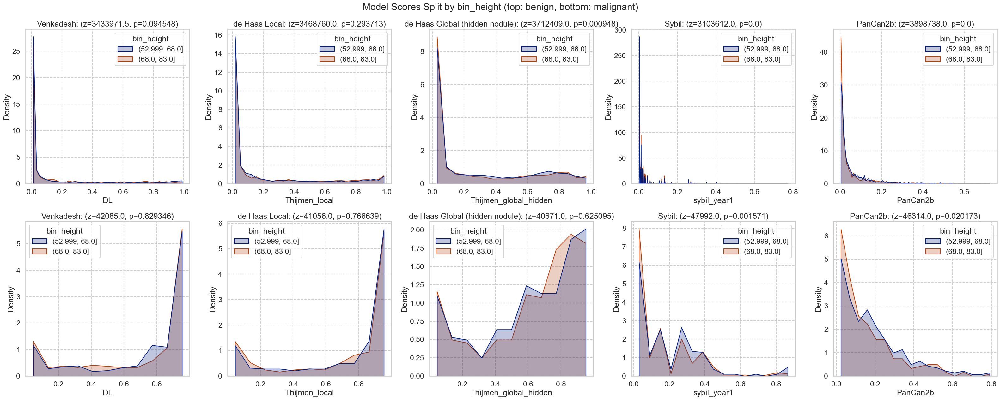

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                               weight  \
                  count      mean       std  min  25%  50%  75%  max   count   
bin_weight                                                                     
(74.999, 180.0]  3082.0  0.106424  0.308430  0.0  0.0  0.0  0.0  1.0  3082.0   
(180.0, 368.0]   2816.0  0.087713  0.282927  0.0  0.0  0.0  0.0  1.0  2816.0   

                                                                           
                       mean        std    min    25%    50%    75%    max  
bin_weight                                                                 
(74.999, 180.0]  152.228423  20.400591   75.0  139.0  155.0  170.0  180.0  
(180.0, 368.0]   214.422585  27.365632  181.0  193.0  208.0  230.0  368.0

### bin_weight

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\2396763895.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
"(74.999, 180.0]",3082,52.255002,328,10.642440,0.235553,0.344333,0.266392,0.355091,0.317912,0.343345,0.042935,0.099434,0.078354,0.114532
"(180.0, 368.0]",2816,47.744998,247,8.771307,0.206137,0.324521,0.237603,0.343069,0.262933,0.330478,0.034444,0.090374,0.055426,0.088528


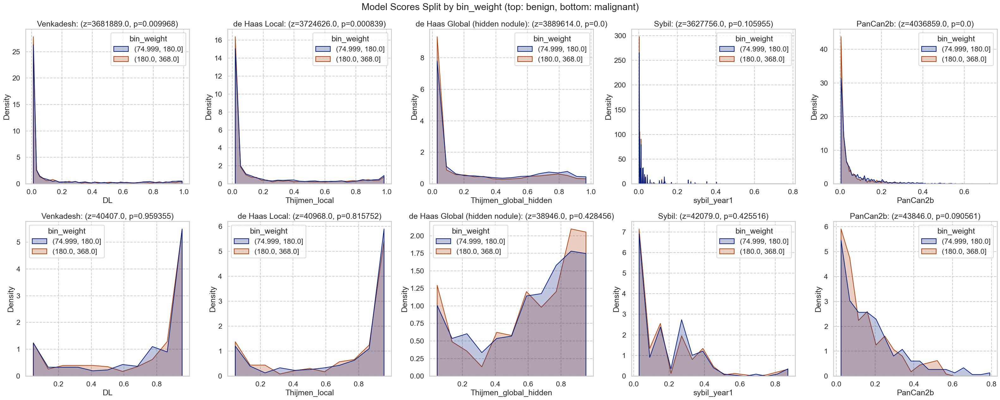

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                                  Age  \
                 count      mean       std  min  25%  50%  75%  max   count   
bin_Age                                                                       
(53.999, 62.0]  2988.0  0.088353  0.283856  0.0  0.0  0.0  0.0  1.0  2988.0   
(62.0, 76.0]    2923.0  0.108450  0.311001  0.0  0.0  0.0  0.0  1.0  2923.0   

                                                                   
                     mean       std   min   25%   50%   75%   max  
bin_Age                                                            
(53.999, 62.0]  58.811245  2.123374  54.0  57.0  59.0  61.0  62.0  
(62.0, 76.0]    67.653780  3.453298  63.0  65.0  67.0  70.0  76.0

### bin_Age

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\2396763895.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
"(53.999, 62.0]",2988,50.549822,264,8.835341,0.199251,0.321086,0.234981,0.338941,0.284420,0.332747,0.032665,0.085911,0.055770,0.089767
"(62.0, 76.0]",2923,49.450178,317,10.845022,0.245655,0.348918,0.272205,0.360403,0.300272,0.344201,0.045747,0.104202,0.080158,0.116518


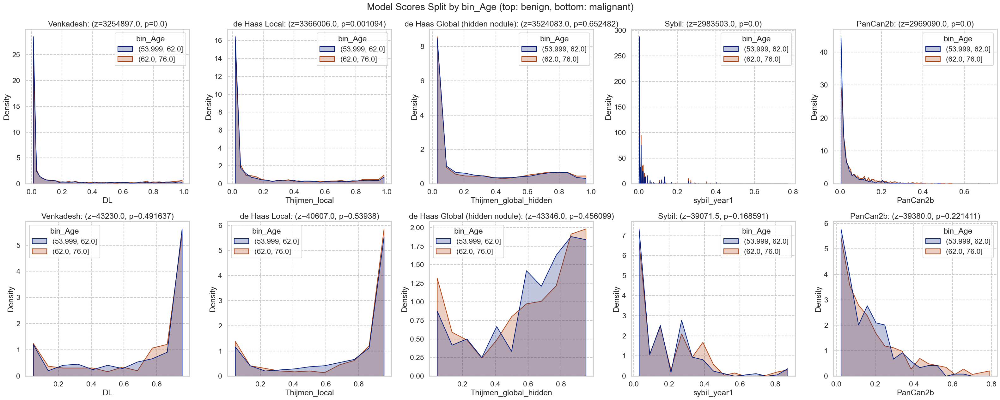

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\33758728.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())


label                                          \
                              count      mean       std  min  25%  50%  75%   
bin_BMI                                                                       
(13.283000000000001, 26.87]  2956.0  0.112314  0.315806  0.0  0.0  0.0  0.0   
(26.87, 57.631]              2936.0  0.082425  0.275058  0.0  0.0  0.0  0.0   

                                     BMI                                  \
                             max   count       mean       std        min   
bin_BMI                                                                    
(13.283000000000001, 26.87]  1.0  2956.0  23.753599  2.257101  13.284203   
(26.87, 57.631]              1.0  2936.0  31.382861  3.818099  26.873766   

                                                                         
                                   25%        50%        75%        max  
bin_BMI                                                                  
(13.283000000000001, 26.87]  22.312778  24.207989  25.603538  26.870222  
(26.87, 57.631]              28.478009  30.406574  33.190637  57.630653

### bin_BMI

C:\Users\shaur\AppData\Local\Temp\ipykernel_13084\2396763895.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups = df.groupby(cat)


,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
"(13.283000000000001, 26.87]",2956,50.169722,332,11.231394,0.247020,0.346949,0.275505,0.359405,0.311561,0.344187,0.044615,0.101522,0.075779,0.112502
"(26.87, 57.631]",2936,49.830278,242,8.242507,0.195655,0.321067,0.229746,0.338065,0.271399,0.331300,0.032877,0.086877,0.058954,0.092981


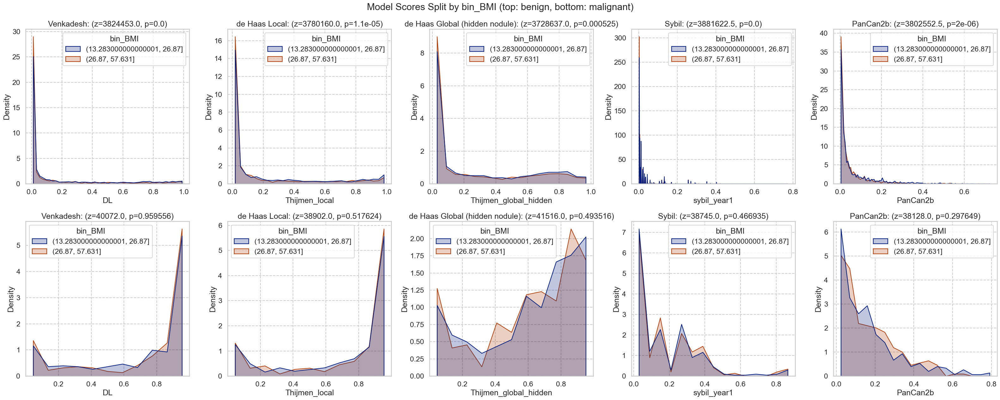

In [27]:
for c in nlst_democols['num']['demo']:
    nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2)
    display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
    plot_by_category(nlst_preds, f'bin_{c}')

label                                               height  \
             count      mean       std  min  25%  50%  75%  max   count   
bin_height                                                                
0.0         3134.0  0.099553  0.299451  0.0  0.0  0.0  0.0  1.0  3134.0   
1.0         2767.0  0.096494  0.295321  0.0  0.0  0.0  0.0  1.0  2767.0   

                                                               
                 mean       std   min   25%   50%   75%   max  
bin_height                                                     
0.0         64.869177  2.355045  53.0  63.0  65.0  67.0  68.0  
1.0         71.503072  1.994545  69.0  70.0  71.0  73.0  83.0

### bin_height

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,3134,53.109642,312,9.955329,0.220647,0.340014,0.246697,0.347355,0.298870,0.336700,0.041066,0.100843,0.073906,0.111685
1.0,2767,46.890358,267,9.649440,0.223613,0.331047,0.260879,0.353214,0.284262,0.340698,0.036658,0.087820,0.060656,0.094616


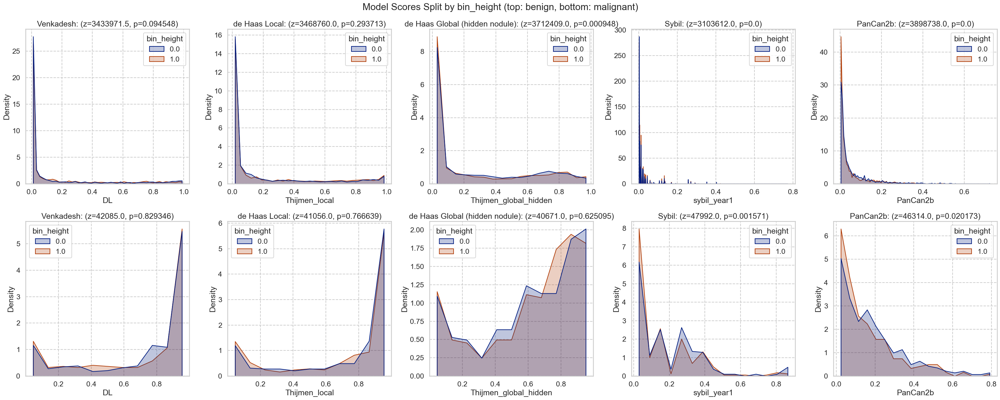

In [ ]:
# nlst_preds['bin_height'] = pd.cut(nlst_preds['height'], bins=[48, 68, 88], right=True, labels=False)
# display(nlst_preds.groupby('bin_height')[['label', 'height']].describe())
# plot_by_category(nlst_preds, f'bin_height')

label                                               weight  \
             count      mean       std  min  25%  50%  75%  max   count   
bin_weight                                                                
0.0         2855.0  0.105779  0.307609  0.0  0.0  0.0  0.0  1.0  2855.0   
1.0         2961.0  0.091523  0.288400  0.0  0.0  0.0  0.0  1.0  2961.0   

                                                                     
                 mean        std    min    25%    50%    75%    max  
bin_weight                                                           
0.0         150.09387  19.487052   88.0  137.0  154.0  165.0  179.0  
1.0         209.49409  23.817196  180.0  190.0  204.0  225.0  279.0

### bin_weight

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,2855,49.088721,302,10.577933,0.237275,0.346549,0.268796,0.356794,0.315402,0.341154,0.044093,0.101342,0.078852,0.114855
1.0,2961,50.911279,271,9.152313,0.208632,0.324994,0.238777,0.342940,0.271106,0.334689,0.034241,0.089798,0.056681,0.090398


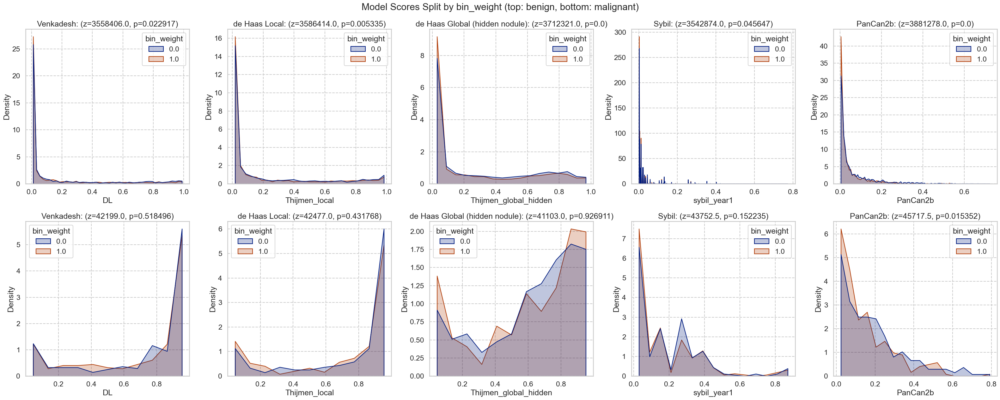

In [ ]:
# nlst_preds['bin_weight'] = pd.cut(nlst_preds['weight'], bins=[79, 179, 279], right=True, labels=False)
# display(nlst_preds.groupby('bin_weight')[['label', 'weight']].describe())
# plot_by_category(nlst_preds, f'bin_weight')

### Smoking columns

#### pkyr

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,57.459653,24.397554,30.0,40.0,50.0,68.0,260.0
1,581.0,66.164716,30.131594,30.0,45.0,56.0,84.0,232.0


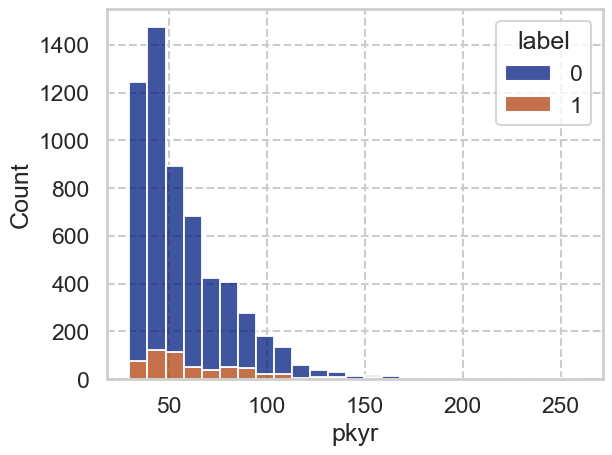

#### smokeage

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,16.524015,3.508332,5.0,15.0,16.0,18.0,40.0
1,581.0,16.204819,3.520048,6.0,14.0,16.0,18.0,30.0


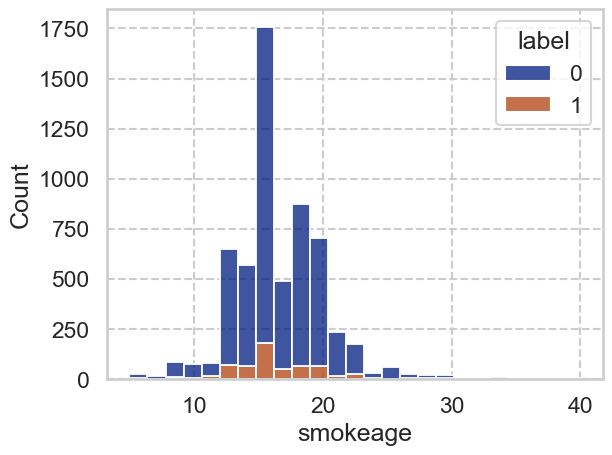

#### smokeday

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,28.436961,11.575912,12.0,20.0,25.0,35.0,135.0
1,581.0,30.485370,12.745731,15.0,20.0,30.0,40.0,80.0


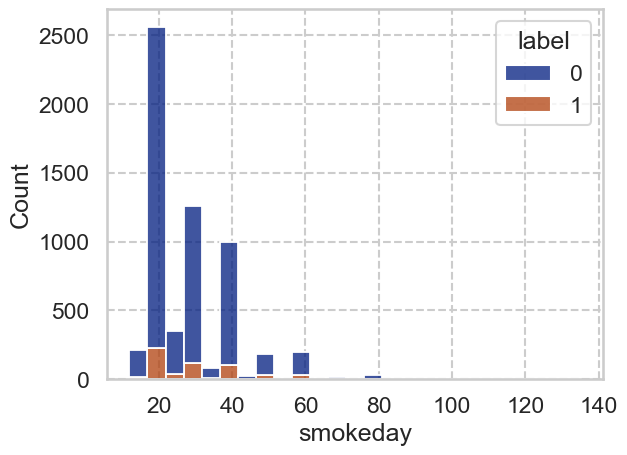

#### smokeyr

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,40.903940,7.364423,16.0,36.0,41.0,46.0,67.0
1,581.0,43.595525,7.225905,25.0,39.0,44.0,49.0,65.0


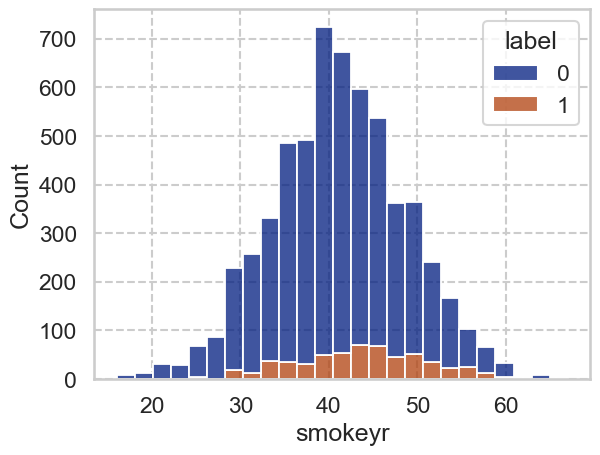

In [22]:
for c in nlst_democols['num']['smoke']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

label                                                 pkyr  \
           count      mean       std  min  25%  50%  75%  max   count   
bin_pkyr                                                                
0         3027.0  0.079617  0.270744  0.0  0.0  0.0  0.0  1.0  3027.0   
1         2884.0  0.117892  0.322536  0.0  0.0  0.0  0.0  1.0  2884.0   

                                                                
               mean        std    min   25%   50%   75%    max  
bin_pkyr                                                        
0         40.627800   5.760036  30.00  36.0  41.0  45.0   51.0  
1         76.879785  24.261537  51.25  60.0  70.0  87.5  260.0

### bin_pkyr

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,3027,51.209609,241,7.961678,0.198989,0.319435,0.229155,0.333597,0.289065,0.332685,0.034451,0.088649,0.063129,0.098795
1,2884,48.790391,340,11.789182,0.246557,0.350785,0.278824,0.365119,0.295611,0.344571,0.044049,0.102196,0.072764,0.110098


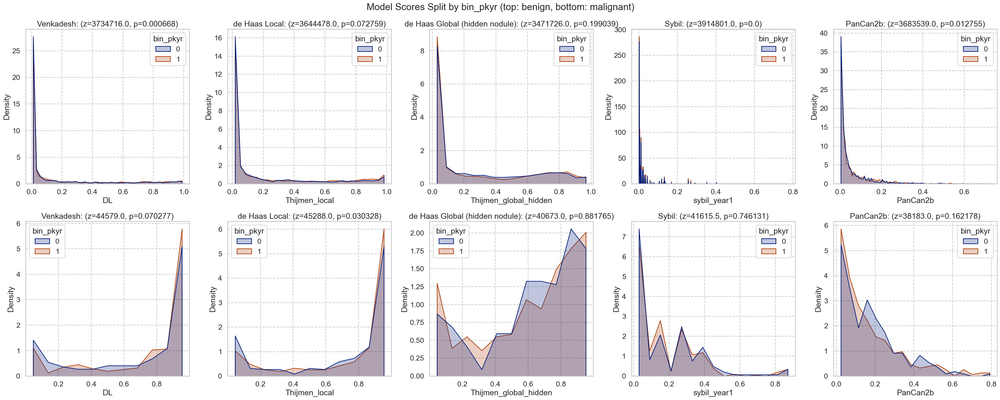

label                                              smokeage  \
               count      mean       std  min  25%  50%  75%  max    count   
bin_smokeage                                                                 
0             3256.0  0.106572  0.308616  0.0  0.0  0.0  0.0  1.0   3256.0   
1             2655.0  0.088136  0.283545  0.0  0.0  0.0  0.0  1.0   2655.0   

                                                                 
                   mean       std   min   25%   50%   75%   max  
bin_smokeage                                                     
0             14.136978  2.000377   5.0  13.0  15.0  16.0  16.0  
1             19.381544  2.716198  17.0  18.0  18.0  20.0  40.0

### bin_smokeage

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,3256,55.083742,347,10.657248,0.229202,0.33843,0.252577,0.348920,0.294486,0.341463,0.039835,0.095738,0.068351,0.104938
1,2655,44.916258,234,8.813559,0.213608,0.33266,0.254384,0.351791,0.289527,0.334927,0.038274,0.095466,0.067191,0.104122


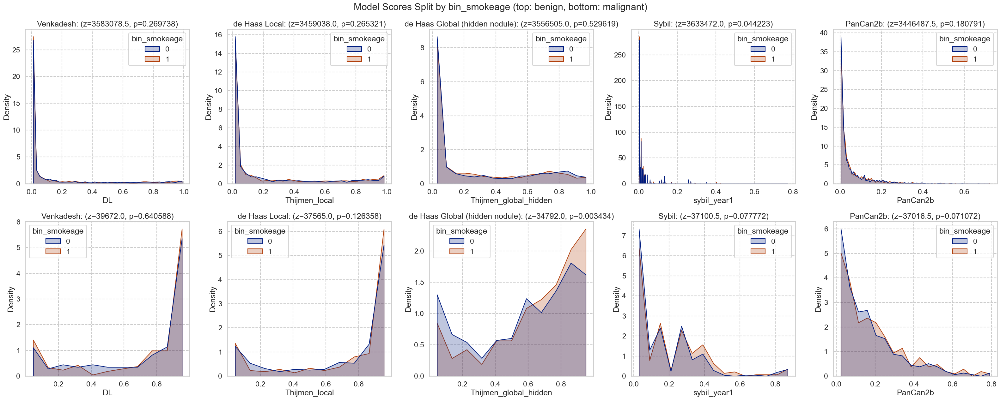

label                                              smokeday  \
               count      mean       std  min  25%  50%  75%  max    count   
bin_smokeday                                                                 
0             3119.0  0.089772  0.285901  0.0  0.0  0.0  0.0  1.0   3119.0   
1             2792.0  0.107808  0.310193  0.0  0.0  0.0  0.0  1.0   2792.0   

                                                                   
                   mean        std   min   25%   50%   75%    max  
bin_smokeday                                                       
0             20.117025   2.153974  12.0  20.0  20.0  20.0   25.0  
1             38.157593  10.650142  26.0  30.0  40.0  40.0  135.0

### bin_smokeday

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,3119,52.766029,280,8.977236,0.210921,0.326994,0.241095,0.340962,0.296261,0.336507,0.036906,0.092053,0.066447,0.100965
1,2792,47.233971,301,10.780802,0.234796,0.345225,0.267123,0.359771,0.287788,0.340767,0.041623,0.099393,0.069374,0.108443


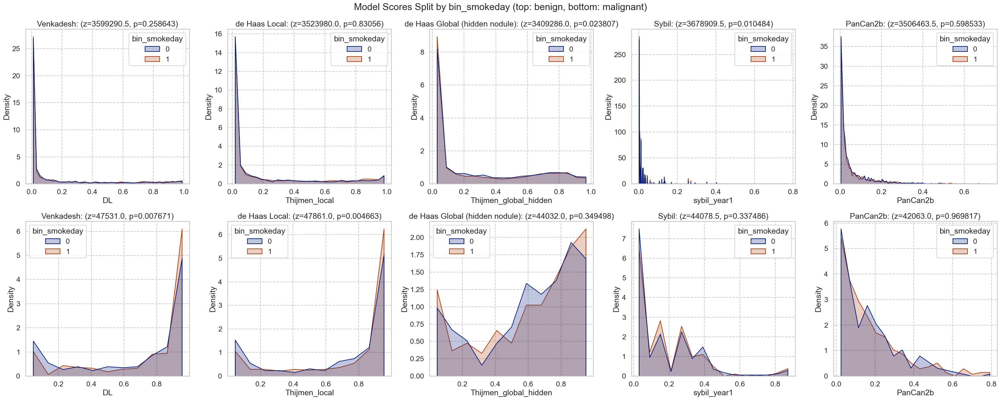

label                                              smokeyr  \
              count      mean       std  min  25%  50%  75%  max   count   
bin_smokeyr                                                                
0            3073.0  0.070290  0.255676  0.0  0.0  0.0  0.0  1.0  3073.0   
1            2838.0  0.128612  0.334829  0.0  0.0  0.0  0.0  1.0  2838.0   

                                                                
                  mean       std   min   25%   50%   75%   max  
bin_smokeyr                                                     
0            35.559714  4.645131  16.0  33.0  36.0  39.0  41.0  
1            47.241720  4.421492  42.0  44.0  46.0  50.0  67.0

### bin_smokeyr

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,3073,51.987819,216,7.028962,0.195573,0.316243,0.230012,0.335716,0.275061,0.329908,0.030808,0.081404,0.056767,0.091287
1,2838,48.012181,365,12.861170,0.251027,0.353790,0.278701,0.363572,0.310880,0.346710,0.048149,0.108220,0.079808,0.116093


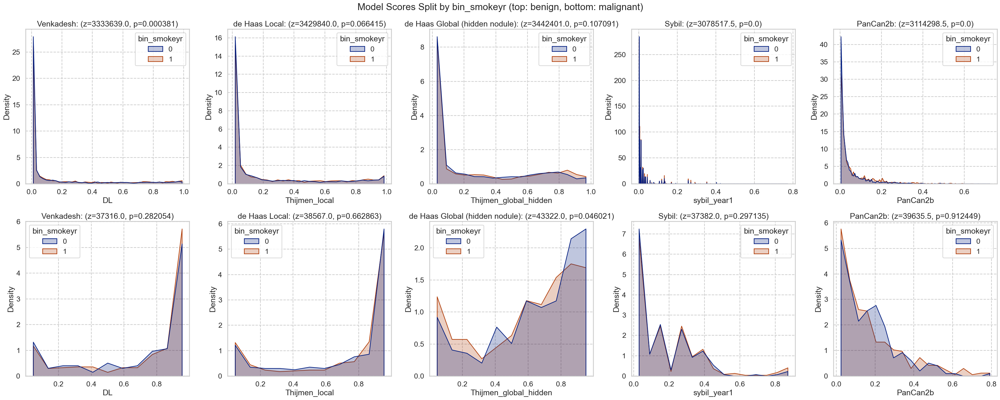

In [23]:
for c in nlst_democols['num']['smoke']:
    nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2, labels=False)
    display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
    plot_by_category(nlst_preds, f'bin_{c}')

### Included columns from predictions

#### Diameter [mm]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,8.446379,5.104287,4.0,5.2,6.8,9.7,64.7
1,581.0,14.567642,9.611311,4.1,8.5,12.2,17.8,83.0


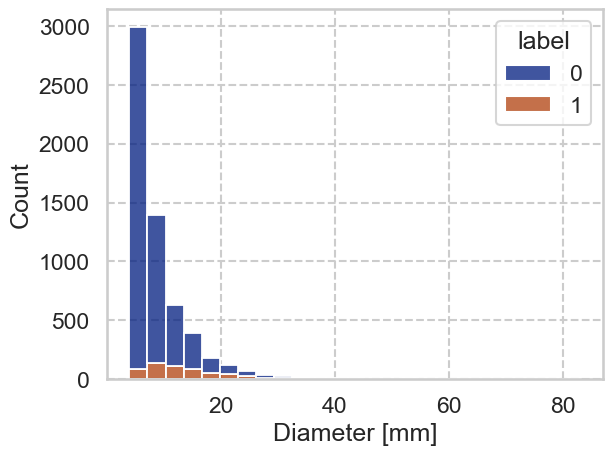

#### NoduleCounts

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,5330.0,1.857786,1.240176,1.0,1.0,1.0,2.0,11.0
1,581.0,2.287435,1.300529,1.0,1.0,2.0,3.0,11.0


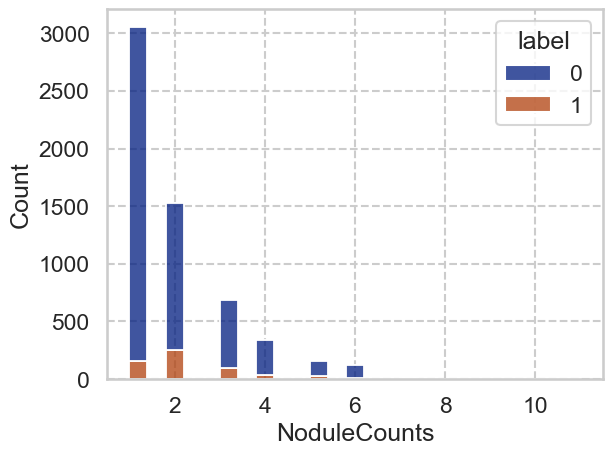

In [24]:
included_num_cols = ["Diameter [mm]", "NoduleCounts"]
for c in included_num_cols:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

label                                               \
                   count      mean       std  min  25%  50%  75%  max   
bin_NoduleCounts                                                        
0                 3054.0  0.050753  0.219529  0.0  0.0  0.0  0.0  1.0   
1                 2857.0  0.149107  0.356257  0.0  0.0  0.0  0.0  1.0   

                 NoduleCounts                                                
                        count      mean       std  min  25%  50%  75%   max  
bin_NoduleCounts                                                             
0                      3054.0  1.000000  0.000000  1.0  1.0  1.0  1.0   1.0  
1                      2857.0  2.862093  1.206261  2.0  2.0  2.0  3.0  11.0

### bin_NoduleCounts

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,3054,51.666385,155,5.075311,0.159672,0.289007,0.194239,0.313489,0.408133,0.340676,0.025700,0.066155,0.060295,0.096135
1,2857,48.333615,426,14.910746,0.289035,0.368186,0.316617,0.375452,0.168394,0.288739,0.053494,0.117640,0.075884,0.112342


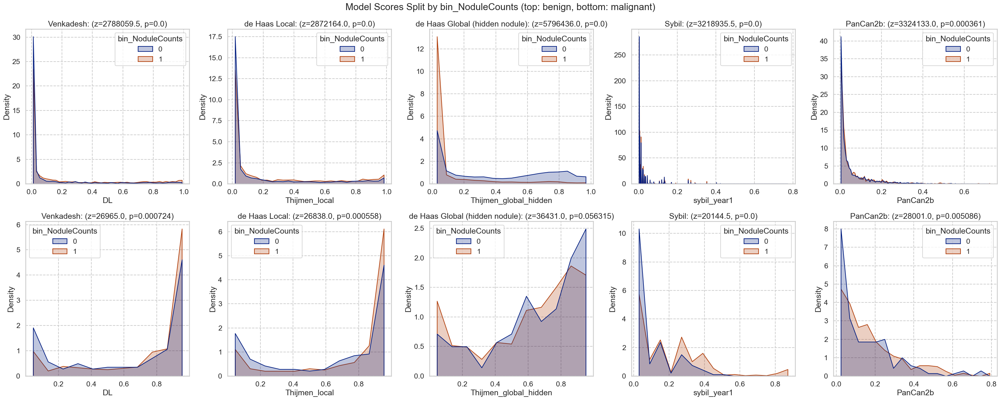

In [25]:
# for c in included_num_cols:
#     nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2, duplicates='drop')
#     display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
#     plot_by_category(nlst_preds, f'bin_{c}')
nlst_preds['bin_NoduleCounts'] = pd.cut(nlst_preds['NoduleCounts'], bins=[0, 1, 12], right=True, labels=False)
display(nlst_preds.groupby(f'bin_NoduleCounts')[['label', f'NoduleCounts']].describe())
plot_by_category(nlst_preds, f'bin_NoduleCounts')

label                                               \
                    count      mean       std  min  25%  50%  75%  max   
bin_Diameter [mm]                                                        
0                  2993.0  0.028065  0.165188  0.0  0.0  0.0  0.0  1.0   
1                  2918.0  0.170322  0.375980  0.0  0.0  0.0  0.0  1.0   

                  Diameter [mm]                                             \
                          count       mean       std  min  25%   50%   75%   
bin_Diameter [mm]                                                            
0                        2993.0   5.437755  0.878854  4.0  4.7   5.4   6.2   
1                        2918.0  12.751131  6.694085  7.2  8.5  10.6  14.6   

                         
                    max  
bin_Diameter [mm]        
0                   7.1  
1                  83.0

### bin_Diameter [mm]

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,2993,50.63441,84,2.806549,0.065931,0.179578,0.091470,0.207661,0.254583,0.318973,0.008673,0.031422,0.010979,0.010434
1,2918,49.36559,497,17.032214,0.382481,0.380501,0.419469,0.386947,0.330903,0.353373,0.070378,0.124820,0.126141,0.123787


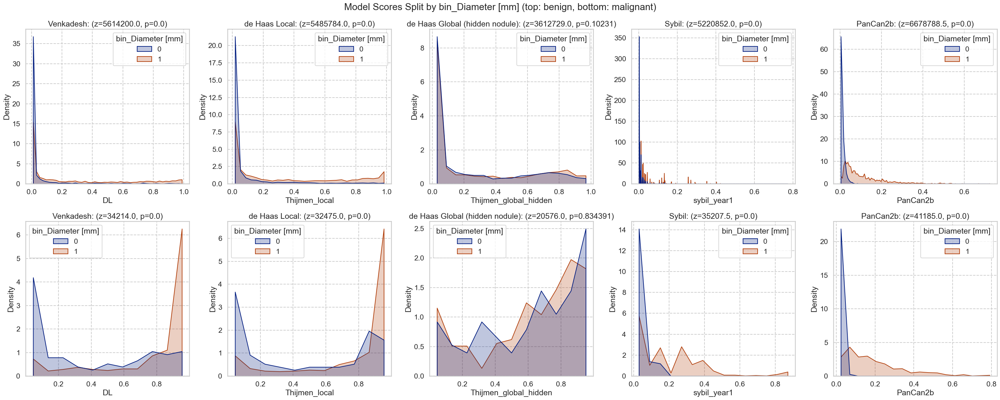

In [26]:
nlst_preds['bin_Diameter [mm]'] = pd.qcut(nlst_preds['Diameter [mm]'], q=2, labels=False)
display(nlst_preds.groupby(f'bin_Diameter [mm]')[['label', f'Diameter [mm]']].describe())
plot_by_category(nlst_preds, f'bin_Diameter [mm]')